<a href="https://colab.research.google.com/github/Yash-Narnaware/ANN-CS-504/blob/main/PA_5_2024AIM1011.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Programming Assignment - 5**

# **Creating a custom LSTM**

**General Instructions**

*  Make your own copy of the file to work with
*  Start **early** as the experiments may take time to run
*  Make sure your lab contains all necessary outputs and graphs.
*  **Code Readability** is very important
*  **DO NOT** use libraries apart from the ones that are explicitly made permissible
*   Save your assignment (as a single Jupyter notebook) in the format PA-5-2021CSBXXXX.ipynb (with your entry number) and upload to Google Classroom

In [ ]:
#------------------ DO NOT EDIT --------------------------
!pip install -q "tqdm>=4.36.1"

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import pandas as pd
import numpy as np

# seaborn - Python data visualization library based on matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# Tqdm is a Python library that provides fast,
# extensible progress bars for loops and iterables.
from tqdm.notebook import tqdm

# math module provides access to the mathematical functions defined by the C standard
import math

torch.manual_seed(0)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(0)


In [ ]:
#---------------------------- DO NOT EDIT --------------------------
# Following code snippet generates a binary sequence for Training
#-------------------------------------------------------------------
num_samples  = 1000
sequence_len = 10

# Sequences
X_train = np.zeros((num_samples, sequence_len))
for row_idx in range(num_samples):
    X_train[row_idx,:] = np.around(np.random.rand(sequence_len)).astype(int)
print("Dataset X_train",X_train)

# Sample target
y_train = np.sum(X_train, axis=1)
print("Label Set",y_train)


X_test = np.asmatrix([[0, 1, 1, 0, 1, 0, 1, 1, 1, 1]])
y_test = X_test.sum()
print("Sample testing Label",y_test)


# Necessary preprocessing of data
X_train= torch.Tensor(X_train)
y_train=torch.Tensor(y_train)
X_test= torch.tensor(X_test)
y_test=torch.tensor(y_test)
y_test=torch.unsqueeze(y_test, 0)

ds_train = torch.utils.data.TensorDataset(X_train, y_train)
train_loader = torch.utils.data.DataLoader(ds_train, batch_size=32, shuffle=True)

ds_test = torch.utils.data.TensorDataset(X_test, y_test)
test_loader = torch.utils.data.DataLoader(ds_test, batch_size=32, shuffle=True)


Dataset X_train [[1. 1. 1. ... 1. 1. 0.]
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 0. ... 1. 1. 0.]
 ...
 [0. 1. 0. ... 0. 1. 1.]
 [0. 1. 1. ... 1. 1. 1.]
 [1. 0. 0. ... 1. 0. 1.]]
Label Set [ 7.  7.  6.  7.  3.  3.  3.  4.  5.  4.  7.  7.  6.  6.  7.  5.  6.  4.
  7.  2.  4.  5.  7.  2.  4.  7.  4.  8.  4.  5.  3.  5.  2.  5.  4.  5.
  6.  6.  7.  2.  4.  1.  5.  5.  6.  5.  2.  9.  4.  4.  4.  6.  4.  5.
  7.  5.  9.  4.  3.  6.  3.  4.  7.  5.  6.  3.  4.  5.  5.  5.  1.  4.
  7.  3.  6.  4.  6.  4.  2.  4.  6.  4.  3.  6.  4.  5.  5.  4.  7.  4.
  3.  5.  7.  3.  4.  4.  3.  6.  8.  5.  5.  3.  6.  4.  5.  4.  4.  5.
  7.  6.  5.  3.  8.  5.  3.  5.  5.  4.  7.  4.  7.  6.  6.  1.  6.  7.
  7.  7.  2.  5.  7.  7.  5.  5.  6.  4.  8.  5.  5.  8.  4.  3.  4.  4.
  5.  7.  7.  5.  5.  3.  7.  5.  8.  6.  4.  6.  4.  5.  8.  5.  6.  4.
  8.  4.  5.  5.  4.  5.  6.  5.  5.  3.  3.  2.  5.  5.  6.  4.  5.  8.
  5.  8.  6.  5.  5.  3.  4.  4.  4.  8.  9.  3.  5.  3.  6.  6.  4.  4.
  6.  6.  4.  2

In [ ]:
#---------------------------- DO NOT EDIT --------------------------
# Following code snippet generates a batch of binary sequence for Testing
#-------------------------------------------------------------------
num_samples = 10
sequence_len = 10

# Sequences
Testing_X = np.zeros((num_samples, sequence_len))
for row_idx in range(num_samples):
    Testing_X[row_idx,:] = np.around(np.random.rand(sequence_len)).astype(int)
print(Testing_X)

# Batch Targets
Testing_Y = np.sum(Testing_X, axis=1)
print(Testing_Y)

# Necessary preprocessing of data
Testing_X = torch.tensor(Testing_X)
Testing_Y=torch.tensor(Testing_Y)
# Testing_Y=torch.unsqueeze(Testing_Y, 0)

ds_test_batch = torch.utils.data.TensorDataset(Testing_X, Testing_Y)
test_loader_batch = torch.utils.data.DataLoader(ds_test_batch, batch_size=10, shuffle=True)

[[1. 0. 0. 0. 0. 1. 0. 0. 0. 1.]
 [1. 0. 1. 0. 1. 0. 0. 0. 1. 0.]
 [1. 1. 0. 1. 1. 1. 1. 0. 0. 0.]
 [1. 0. 1. 1. 0. 1. 0. 0. 1. 1.]
 [1. 0. 1. 1. 1. 0. 0. 1. 0. 0.]
 [0. 0. 1. 0. 1. 1. 0. 0. 0. 1.]
 [1. 1. 1. 1. 0. 1. 0. 1. 0. 1.]
 [0. 0. 0. 1. 0. 0. 1. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 1. 0. 1. 1.]
 [0. 1. 0. 0. 1. 0. 1. 0. 0. 1.]]
[3. 4. 6. 6. 5. 4. 7. 3. 4. 4.]


# Creating a custom LSTM Cell
---
The aim of this section is to understand the internal working of LSTM cells as how different gates regulate information flow and how it is accumulated sequentially.

## To do

---
**Study and Implement the custom lstm with following gates:**

* Input Gate (i_t) **(5 points)**
* Output Gate (o_t) **(5 points)**
* Forget Gate (f_t) **(5 points)**
* Cell State (c_t) **(5 points)**
* Forward pass **(5 points)**
* Other parts of implementation **(10 points)**

In [ ]:
# Template for the Custom LSTM Cell given below
# Include paramters as required and implement all necessary methods

class CustomLSTMCell(nn.Module):

    # Define weights for input, output, forget gates and cell state
    def __init__(self, input_size, hidden_size):
        super(CustomLSTMCell, self).__init__()
        self.hidden_size = hidden_size
        self.W_input = nn.Linear(input_size + hidden_size, hidden_size)
        self.W_forget = nn.Linear(input_size + hidden_size, hidden_size)
        self.W_candidate = nn.Linear(input_size + hidden_size, hidden_size)
        self.W_output = nn.Linear(input_size + hidden_size, hidden_size)

        # Initialize weights
        self.init_weights()

    # Initialization of weights
    def init_weights(self):


        # # Xavier initialization for weights
        nn.init.xavier_uniform_(self.W_input.weight)
        nn.init.xavier_uniform_(self.W_forget.weight)
        nn.init.xavier_uniform_(self.W_candidate.weight)
        nn.init.xavier_uniform_(self.W_output.weight)


        # Initialize weights with random values between 0 and 1
        # self.W_input.weight.data = torch.rand(self.W_input.weight.size())
        # self.W_forget.weight.data = torch.rand(self.W_forget.weight.size())
        # self.W_candidate.weight.data = torch.rand(self.W_candidate.weight.size())
        # self.W_output.weight.data = torch.rand(self.W_output.weight.size())

        # Initialize biases to zero
        nn.init.zeros_(self.W_input.bias)
        # nn.init.zeros_(self.W_forget.bias)
        self.W_forget.bias.data.fill_(1)
        nn.init.zeros_(self.W_candidate.bias)
        nn.init.zeros_(self.W_output.bias)


    # Implementation of gates
    def forget_gate(self, combined_X_h):
        return torch.sigmoid(self.W_forget(combined_X_h))



    def input_gate(self, combined_X_h):
        return torch.sigmoid(self.W_input(combined_X_h))


    def cell_gate(self, combined_X_h):
        return torch.tanh(self.W_candidate(combined_X_h))


    def output_gate(self, combined_X_h):
        return torch.sigmoid(self.W_output(combined_X_h))


    # Forward Pass
    def forward(self, x, h_prev, cell_state_prev):

        x = x.squeeze(-1)
        combined_X_h = torch.cat((x, h_prev), dim=1)

        # print(combined_X_h)

        forget_gate = self.forget_gate(combined_X_h)
        input_gate = self.input_gate(combined_X_h)
        candidate_cell_state = self.cell_gate(combined_X_h)
        output = self.output_gate(combined_X_h)

        cell_state_new = forget_gate*cell_state_prev + input_gate*candidate_cell_state
        h_new = torch.tanh(cell_state_new)*output

        return h_new, cell_state_new

# Creating a custom LSTM Network **(10 Points)**

To do

---
Creating a network of customLSTM with 2 linear layers at end and hidden nodes is a hyperparameter


In [ ]:
# Template for the LSTM Network given below
# Include paramters as required and implement all necessary methods
# Network with 2 linear layers at the end and hidden nodes as hyperparameter
class customLSTM(nn.Module):

    def __init__(self, input_size, hidden_size, output_size):
        super(customLSTM, self).__init__()
        self.hidden_size = hidden_size

        self.lstm_cell = CustomLSTMCell(input_size, hidden_size)
        self.fc_layer1 = nn.Linear(hidden_size, 64)
        self.fc_layer2 = nn.Linear(64, output_size)

    def forward(self, x):

        h, c = torch.zeros(x.size(0), self.hidden_size).to(x.device), torch.zeros(x.size(0), self.hidden_size).to(x.device)

        for t in range(x.size(1)):
            h, c = self.lstm_cell(x[:, t].unsqueeze(1), h, c)

        x = torch.relu(self.fc_layer1(h))
        x = self.fc_layer2(x)
        return x



# Train CustomLSTM - 1 **(5 Points)**

* Use Adam optimizer and experiment with various learning rates
* Use L1 Loss
* Test the customLSTM on sample test point first and then on batch test data
* Use a combination of hyperparameters which lead to fastest convergence
* -- (less epochs for training) with less expenses for L1 loss


In [ ]:
# Train customLSTM - 1
# Plot loss and accuracy curves
# Print Training accuracy

# Initialize and Train with L1 Loss
input_size = 1
hidden_size = 64
output_size = 1

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_l1 = customLSTM(input_size, hidden_size, output_size).to(device)

# model_l1 = customLSTM(input_size, hidden_size, output_size)
criterion_l1 = nn.L1Loss()
optimizer_l1 = optim.Adam(model_l1.parameters(), lr=0.01)

num_epochs = 2000

# Training
losses = []
for epoch in range(num_epochs):
    running_loss = 0.0

    for X_batch, y_batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        X_batch = X_batch.unsqueeze(-1).to(device)
        y_batch = y_batch.unsqueeze(-1).to(device)

        optimizer_l1.zero_grad()
        outputs = model_l1(X_batch)
        loss = criterion_l1(outputs, y_batch)
        loss.backward()
        optimizer_l1.step()
        running_loss += loss.item()

    epoch_loss = running_loss / len(train_loader)
    losses.append(epoch_loss)

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {losses[-1]}")

Epoch 1/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1/2000, Loss: 1.8169542774558067


Epoch 2/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 2/2000, Loss: 1.2879596967250109


Epoch 3/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 3/2000, Loss: 1.2673715986311436


Epoch 4/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 4/2000, Loss: 1.1354174390435219


Epoch 5/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 5/2000, Loss: 0.7420054469257593


Epoch 6/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 6/2000, Loss: 0.3069510906934738


Epoch 7/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 7/2000, Loss: 0.19471340137533844


Epoch 8/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 8/2000, Loss: 0.25303899869322777


Epoch 9/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 9/2000, Loss: 0.17710200627334416


Epoch 10/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 10/2000, Loss: 0.17402155161835253


Epoch 11/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 11/2000, Loss: 0.17498652054928243


Epoch 12/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 12/2000, Loss: 0.15664466051384807


Epoch 13/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 13/2000, Loss: 0.13661398156546056


Epoch 14/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 14/2000, Loss: 0.11358238395769149


Epoch 15/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 15/2000, Loss: 0.11021520325448364


Epoch 16/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 16/2000, Loss: 0.07324792956933379


Epoch 17/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 17/2000, Loss: 0.12839872809126973


Epoch 18/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 18/2000, Loss: 0.13810865487903357


Epoch 19/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 19/2000, Loss: 0.11668671108782291


Epoch 20/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 20/2000, Loss: 0.18767069175373763


Epoch 21/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 21/2000, Loss: 0.16165445174556226


Epoch 22/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 22/2000, Loss: 0.09323851275257766


Epoch 23/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 23/2000, Loss: 0.14651231456082314


Epoch 24/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 24/2000, Loss: 0.12533482199069113


Epoch 25/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 25/2000, Loss: 0.1026596708688885


Epoch 26/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 26/2000, Loss: 0.07064406387507915


Epoch 27/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 27/2000, Loss: 0.11543389281723648


Epoch 28/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 28/2000, Loss: 0.09478639764711261


Epoch 29/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 29/2000, Loss: 0.17573265149258077


Epoch 30/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 30/2000, Loss: 0.11410123587120324


Epoch 31/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 31/2000, Loss: 0.08297491038683802


Epoch 32/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 32/2000, Loss: 0.07213686953764409


Epoch 33/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 33/2000, Loss: 0.10822669381741434


Epoch 34/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 34/2000, Loss: 0.111940344912


Epoch 35/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 35/2000, Loss: 0.12051197863183916


Epoch 36/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 36/2000, Loss: 0.05896160821430385


Epoch 37/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 37/2000, Loss: 0.06801155646098778


Epoch 38/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 38/2000, Loss: 0.08540050440933555


Epoch 39/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 39/2000, Loss: 0.06726525409612805


Epoch 40/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 40/2000, Loss: 0.04094941838411614


Epoch 41/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 41/2000, Loss: 0.09440292476210743


Epoch 42/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 42/2000, Loss: 0.10647760413121432


Epoch 43/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 43/2000, Loss: 0.04968776274472475


Epoch 44/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 44/2000, Loss: 0.08389584114775062


Epoch 45/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 45/2000, Loss: 0.07483200781280175


Epoch 46/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 46/2000, Loss: 0.061430535512045026


Epoch 47/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 47/2000, Loss: 0.072584108565934


Epoch 48/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 48/2000, Loss: 0.08140815771184862


Epoch 49/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 49/2000, Loss: 0.10199597163591534


Epoch 50/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 50/2000, Loss: 0.07664119801484048


Epoch 51/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 51/2000, Loss: 0.07861426053568721


Epoch 52/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 52/2000, Loss: 0.07800738862715662


Epoch 53/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 53/2000, Loss: 0.05990449071396142


Epoch 54/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 54/2000, Loss: 0.053909418056719005


Epoch 55/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 55/2000, Loss: 0.07407162105664611


Epoch 56/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 56/2000, Loss: 0.06736324046505615


Epoch 57/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 57/2000, Loss: 0.0938315010862425


Epoch 58/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 58/2000, Loss: 0.09021731838583946


Epoch 59/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 59/2000, Loss: 0.05677665397524834


Epoch 60/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 60/2000, Loss: 0.04516609862912446


Epoch 61/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 61/2000, Loss: 0.09691963833756745


Epoch 62/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 62/2000, Loss: 0.06145107408519834


Epoch 63/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 63/2000, Loss: 0.08818318508565426


Epoch 64/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 64/2000, Loss: 0.0780362366931513


Epoch 65/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 65/2000, Loss: 0.10489098017569631


Epoch 66/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 66/2000, Loss: 0.09446497831959277


Epoch 67/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 67/2000, Loss: 0.12376512947957963


Epoch 68/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 68/2000, Loss: 0.10245829855557531


Epoch 69/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 69/2000, Loss: 0.08491054712794721


Epoch 70/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 70/2000, Loss: 0.047094666515477


Epoch 71/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 71/2000, Loss: 0.058073755993973464


Epoch 72/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 72/2000, Loss: 0.061888069729320705


Epoch 73/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 73/2000, Loss: 0.05189336807234213


Epoch 74/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 74/2000, Loss: 0.04453473654575646


Epoch 75/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 75/2000, Loss: 0.05502524663461372


Epoch 76/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 76/2000, Loss: 0.06776800996158272


Epoch 77/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 77/2000, Loss: 0.08469138434156775


Epoch 78/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 78/2000, Loss: 0.1165801954921335


Epoch 79/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 79/2000, Loss: 0.04285370639991015


Epoch 80/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 80/2000, Loss: 0.06297759001608938


Epoch 81/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 81/2000, Loss: 0.07696319429669529


Epoch 82/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 82/2000, Loss: 0.13168892194516957


Epoch 83/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 83/2000, Loss: 0.12014705734327435


Epoch 84/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 84/2000, Loss: 0.06705368857365102


Epoch 85/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 85/2000, Loss: 0.09798537474125624


Epoch 86/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 86/2000, Loss: 0.06889234506525099


Epoch 87/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 87/2000, Loss: 0.0890255436534062


Epoch 88/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 88/2000, Loss: 0.05653268191963434


Epoch 89/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 89/2000, Loss: 0.07677051279461011


Epoch 90/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 90/2000, Loss: 0.07739237014902756


Epoch 91/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 91/2000, Loss: 0.06673018005676568


Epoch 92/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 92/2000, Loss: 0.0760015700943768


Epoch 93/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 93/2000, Loss: 0.04206084716133773


Epoch 94/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 94/2000, Loss: 0.049406133708544075


Epoch 95/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 95/2000, Loss: 0.07262208464089781


Epoch 96/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 96/2000, Loss: 0.052005556877702475


Epoch 97/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 97/2000, Loss: 0.03815370419761166


Epoch 98/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 98/2000, Loss: 0.035138487117365


Epoch 99/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 99/2000, Loss: 0.06910782284103334


Epoch 100/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 100/2000, Loss: 0.04821183905005455


Epoch 101/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 101/2000, Loss: 0.07007198012433946


Epoch 102/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 102/2000, Loss: 0.0896395887248218


Epoch 103/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 103/2000, Loss: 0.0709618505788967


Epoch 104/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 104/2000, Loss: 0.08324544702190906


Epoch 105/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 105/2000, Loss: 0.07038705848390236


Epoch 106/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 106/2000, Loss: 0.04963526222854853


Epoch 107/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 107/2000, Loss: 0.03365102282259613


Epoch 108/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 108/2000, Loss: 0.05658626405056566


Epoch 109/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 109/2000, Loss: 0.05484840995632112


Epoch 110/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 110/2000, Loss: 0.06302496558055282


Epoch 111/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 111/2000, Loss: 0.08379865472670645


Epoch 112/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 112/2000, Loss: 0.04144801461370662


Epoch 113/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 113/2000, Loss: 0.04587586340494454


Epoch 114/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 114/2000, Loss: 0.09358293935656548


Epoch 115/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 115/2000, Loss: 0.12151292175985873


Epoch 116/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 116/2000, Loss: 0.050733649637550116


Epoch 117/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 117/2000, Loss: 0.0654424203094095


Epoch 118/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 118/2000, Loss: 0.08215015043970197


Epoch 119/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 119/2000, Loss: 0.04537088342476636


Epoch 120/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 120/2000, Loss: 0.03797386179212481


Epoch 121/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 121/2000, Loss: 0.05510525347199291


Epoch 122/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 122/2000, Loss: 0.05744543217588216


Epoch 123/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 123/2000, Loss: 0.048221631557680666


Epoch 124/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 124/2000, Loss: 0.041893236397299916


Epoch 125/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 125/2000, Loss: 0.06756900146137923


Epoch 126/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 126/2000, Loss: 0.05296237044967711


Epoch 127/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 127/2000, Loss: 0.06542365229688585


Epoch 128/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 128/2000, Loss: 0.06217118469066918


Epoch 129/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 129/2000, Loss: 0.09318354597780854


Epoch 130/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 130/2000, Loss: 0.044431498856283724


Epoch 131/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 131/2000, Loss: 0.03734833438647911


Epoch 132/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 132/2000, Loss: 0.02691013237927109


Epoch 133/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 133/2000, Loss: 0.061306592309847474


Epoch 134/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 134/2000, Loss: 0.04557331372052431


Epoch 135/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 135/2000, Loss: 0.04185749520547688


Epoch 136/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 136/2000, Loss: 0.02326944994274527


Epoch 137/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 137/2000, Loss: 0.0374295226065442


Epoch 138/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 138/2000, Loss: 0.03496936912415549


Epoch 139/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 139/2000, Loss: 0.04981937457341701


Epoch 140/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 140/2000, Loss: 0.05021093983668834


Epoch 141/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 141/2000, Loss: 0.06939776777289808


Epoch 142/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 142/2000, Loss: 0.07758197735529393


Epoch 143/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 143/2000, Loss: 0.06599754700437188


Epoch 144/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 144/2000, Loss: 0.05466307804454118


Epoch 145/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 145/2000, Loss: 0.036319091450423


Epoch 146/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 146/2000, Loss: 0.04762637848034501


Epoch 147/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 147/2000, Loss: 0.03744186187395826


Epoch 148/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 148/2000, Loss: 0.03712997317779809


Epoch 149/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 149/2000, Loss: 0.03936984890606254


Epoch 150/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 150/2000, Loss: 0.04607311147265136


Epoch 151/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 151/2000, Loss: 0.05801652080845088


Epoch 152/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 152/2000, Loss: 0.05256872728932649


Epoch 153/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 153/2000, Loss: 0.05888011760544032


Epoch 154/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 154/2000, Loss: 0.04290097544435412


Epoch 155/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 155/2000, Loss: 0.04448595445137471


Epoch 156/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 156/2000, Loss: 0.030065551167353988


Epoch 157/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 157/2000, Loss: 0.0609689966076985


Epoch 158/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 158/2000, Loss: 0.03687985008582473


Epoch 159/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 159/2000, Loss: 0.06251201464328915


Epoch 160/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 160/2000, Loss: 0.02900052210316062


Epoch 161/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 161/2000, Loss: 0.033750774688087404


Epoch 162/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 162/2000, Loss: 0.05305810464778915


Epoch 163/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 163/2000, Loss: 0.07472366304136813


Epoch 164/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 164/2000, Loss: 0.07839802000671625


Epoch 165/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 165/2000, Loss: 0.046138732926920056


Epoch 166/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 166/2000, Loss: 0.04507277440279722


Epoch 167/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 167/2000, Loss: 0.053295383346267045


Epoch 168/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 168/2000, Loss: 0.04287412163102999


Epoch 169/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 169/2000, Loss: 0.02973567834123969


Epoch 170/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 170/2000, Loss: 0.04547913547139615


Epoch 171/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 171/2000, Loss: 0.0752716570859775


Epoch 172/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 172/2000, Loss: 0.037490981398150325


Epoch 173/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 173/2000, Loss: 0.04487015807535499


Epoch 174/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 174/2000, Loss: 0.03695021802559495


Epoch 175/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 175/2000, Loss: 0.03633701044600457


Epoch 176/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 176/2000, Loss: 0.02392134821275249


Epoch 177/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 177/2000, Loss: 0.030044776620343328


Epoch 178/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 178/2000, Loss: 0.04623804840957746


Epoch 179/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 179/2000, Loss: 0.072775884764269


Epoch 180/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 180/2000, Loss: 0.04808501875959337


Epoch 181/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 181/2000, Loss: 0.03792811348102987


Epoch 182/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 182/2000, Loss: 0.020086559816263616


Epoch 183/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 183/2000, Loss: 0.04094785335473716


Epoch 184/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 184/2000, Loss: 0.04156390705611557


Epoch 185/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 185/2000, Loss: 0.06770321202930063


Epoch 186/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 186/2000, Loss: 0.041281602811068296


Epoch 187/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 187/2000, Loss: 0.03893608844373375


Epoch 188/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 188/2000, Loss: 0.08303961006458849


Epoch 189/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 189/2000, Loss: 0.09684594837017357


Epoch 190/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 190/2000, Loss: 0.05967765545938164


Epoch 191/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 191/2000, Loss: 0.05267098767217249


Epoch 192/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 192/2000, Loss: 0.041222716215997934


Epoch 193/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 193/2000, Loss: 0.06334724510088563


Epoch 194/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 194/2000, Loss: 0.06446101563051343


Epoch 195/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 195/2000, Loss: 0.03962521656649187


Epoch 196/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 196/2000, Loss: 0.05470867577241734


Epoch 197/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 197/2000, Loss: 0.03137800854165107


Epoch 198/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 198/2000, Loss: 0.08216097194235772


Epoch 199/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 199/2000, Loss: 0.04787994280923158


Epoch 200/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 200/2000, Loss: 0.042643108463380486


Epoch 201/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 201/2000, Loss: 0.033405624562874436


Epoch 202/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 202/2000, Loss: 0.0286427186219953


Epoch 203/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 203/2000, Loss: 0.0585301598184742


Epoch 204/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 204/2000, Loss: 0.04344380530528724


Epoch 205/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 205/2000, Loss: 0.03475926804821938


Epoch 206/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 206/2000, Loss: 0.03731238067848608


Epoch 207/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 207/2000, Loss: 0.0394587516784668


Epoch 208/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 208/2000, Loss: 0.0381660315906629


Epoch 209/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 209/2000, Loss: 0.03708363964688033


Epoch 210/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 210/2000, Loss: 0.03201593831181526


Epoch 211/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 211/2000, Loss: 0.04281320160953328


Epoch 212/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 212/2000, Loss: 0.04272026161197573


Epoch 213/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 213/2000, Loss: 0.026188868563622236


Epoch 214/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 214/2000, Loss: 0.020319145289249718


Epoch 215/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 215/2000, Loss: 0.05462200113106519


Epoch 216/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 216/2000, Loss: 0.0434873653575778


Epoch 217/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 217/2000, Loss: 0.045382047013845295


Epoch 218/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 218/2000, Loss: 0.04792595491744578


Epoch 219/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 219/2000, Loss: 0.03229880961589515


Epoch 220/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 220/2000, Loss: 0.04300502111436799


Epoch 221/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 221/2000, Loss: 0.03641405462985858


Epoch 222/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 222/2000, Loss: 0.037470519193448126


Epoch 223/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 223/2000, Loss: 0.03434368618763983


Epoch 224/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 224/2000, Loss: 0.03573447174858302


Epoch 225/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 225/2000, Loss: 0.054573227535001934


Epoch 226/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 226/2000, Loss: 0.04757319064810872


Epoch 227/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 227/2000, Loss: 0.03837719204602763


Epoch 228/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 228/2000, Loss: 0.03551269497256726


Epoch 229/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 229/2000, Loss: 0.04444053990300745


Epoch 230/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 230/2000, Loss: 0.03550098103005439


Epoch 231/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 231/2000, Loss: 0.024661926028784364


Epoch 232/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 232/2000, Loss: 0.04314099997282028


Epoch 233/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 233/2000, Loss: 0.032992896041832864


Epoch 234/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 234/2000, Loss: 0.05120687815360725


Epoch 235/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 235/2000, Loss: 0.03801909217145294


Epoch 236/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 236/2000, Loss: 0.03286047949222848


Epoch 237/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 237/2000, Loss: 0.028555385244544595


Epoch 238/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 238/2000, Loss: 0.028153834282420576


Epoch 239/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 239/2000, Loss: 0.035741982981562614


Epoch 240/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 240/2000, Loss: 0.030008550849743187


Epoch 241/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 241/2000, Loss: 0.04004236590117216


Epoch 242/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 242/2000, Loss: 0.027276254433672875


Epoch 243/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 243/2000, Loss: 0.024506623158231378


Epoch 244/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 244/2000, Loss: 0.026007614098489285


Epoch 245/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 245/2000, Loss: 0.03395314759109169


Epoch 246/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 246/2000, Loss: 0.019548977201338857


Epoch 247/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 247/2000, Loss: 0.030887881526723504


Epoch 248/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 248/2000, Loss: 0.051407042308710515


Epoch 249/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 249/2000, Loss: 0.06141286896308884


Epoch 250/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 250/2000, Loss: 0.026903576974291354


Epoch 251/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 251/2000, Loss: 0.03027797391405329


Epoch 252/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 252/2000, Loss: 0.061420090263709426


Epoch 253/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 253/2000, Loss: 0.04753892292501405


Epoch 254/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 254/2000, Loss: 0.029986325651407242


Epoch 255/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 255/2000, Loss: 0.028763207723386586


Epoch 256/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 256/2000, Loss: 0.036077014869078994


Epoch 257/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 257/2000, Loss: 0.033308460493572056


Epoch 258/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 258/2000, Loss: 0.0378709965152666


Epoch 259/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 259/2000, Loss: 0.05087372870184481


Epoch 260/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 260/2000, Loss: 0.03954524273285642


Epoch 261/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 261/2000, Loss: 0.031460068945307285


Epoch 262/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 262/2000, Loss: 0.03268887609010562


Epoch 263/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 263/2000, Loss: 0.06281280214898288


Epoch 264/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 264/2000, Loss: 0.04395742143969983


Epoch 265/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 265/2000, Loss: 0.020384875882882625


Epoch 266/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 266/2000, Loss: 0.024209018447436392


Epoch 267/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 267/2000, Loss: 0.03266261192038655


Epoch 268/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 268/2000, Loss: 0.023418416385538876


Epoch 269/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 269/2000, Loss: 0.02497729123570025


Epoch 270/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 270/2000, Loss: 0.04193754948209971


Epoch 271/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 271/2000, Loss: 0.02471024915575981


Epoch 272/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 272/2000, Loss: 0.032163800206035376


Epoch 273/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 273/2000, Loss: 0.043513051816262305


Epoch 274/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 274/2000, Loss: 0.025819958187639713


Epoch 275/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 275/2000, Loss: 0.05306236381875351


Epoch 276/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 276/2000, Loss: 0.051334533374756575


Epoch 277/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 277/2000, Loss: 0.05646093166433275


Epoch 278/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 278/2000, Loss: 0.03815331507939845


Epoch 279/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 279/2000, Loss: 0.02593155362410471


Epoch 280/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 280/2000, Loss: 0.030120423529297113


Epoch 281/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 281/2000, Loss: 0.04517706047045067


Epoch 282/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 282/2000, Loss: 0.02488969819387421


Epoch 283/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 283/2000, Loss: 0.04862685961415991


Epoch 284/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 284/2000, Loss: 0.02927725773770362


Epoch 285/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 285/2000, Loss: 0.03493482293561101


Epoch 286/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 286/2000, Loss: 0.028297859244048595


Epoch 287/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 287/2000, Loss: 0.030722955940291286


Epoch 288/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 288/2000, Loss: 0.021141807083040476


Epoch 289/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 289/2000, Loss: 0.022595133923459798


Epoch 290/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 290/2000, Loss: 0.023147674335632473


Epoch 291/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 291/2000, Loss: 0.03403806814458221


Epoch 292/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 292/2000, Loss: 0.046096015779767185


Epoch 293/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 293/2000, Loss: 0.04084751533810049


Epoch 294/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 294/2000, Loss: 0.032687742670532316


Epoch 295/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 295/2000, Loss: 0.040086019958835095


Epoch 296/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 296/2000, Loss: 0.05342262354679406


Epoch 297/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 297/2000, Loss: 0.02931283094221726


Epoch 298/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 298/2000, Loss: 0.039129108597990125


Epoch 299/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 299/2000, Loss: 0.022968712146393955


Epoch 300/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 300/2000, Loss: 0.0350874686264433


Epoch 301/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 301/2000, Loss: 0.029681010637432337


Epoch 302/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 302/2000, Loss: 0.019920800754334778


Epoch 303/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 303/2000, Loss: 0.03204530186485499


Epoch 304/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 304/2000, Loss: 0.025210955180227757


Epoch 305/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 305/2000, Loss: 0.041300725541077554


Epoch 306/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 306/2000, Loss: 0.025774234207347035


Epoch 307/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 307/2000, Loss: 0.02680990006774664


Epoch 308/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 308/2000, Loss: 0.05385083379223943


Epoch 309/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 309/2000, Loss: 0.03963558439863846


Epoch 310/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 310/2000, Loss: 0.04380393022438511


Epoch 311/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 311/2000, Loss: 0.04754370648879558


Epoch 312/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 312/2000, Loss: 0.050909787125419825


Epoch 313/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 313/2000, Loss: 0.026524508837610483


Epoch 314/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 314/2000, Loss: 0.03105564758880064


Epoch 315/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 315/2000, Loss: 0.030274941585958004


Epoch 316/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 316/2000, Loss: 0.020150087715592235


Epoch 317/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 317/2000, Loss: 0.04649410833371803


Epoch 318/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 318/2000, Loss: 0.04736430908087641


Epoch 319/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 319/2000, Loss: 0.03692842094460502


Epoch 320/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 320/2000, Loss: 0.02868064458016306


Epoch 321/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 321/2000, Loss: 0.022740310640074313


Epoch 322/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 322/2000, Loss: 0.046756374824326485


Epoch 323/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 323/2000, Loss: 0.030920673569198698


Epoch 324/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 324/2000, Loss: 0.026573940413072705


Epoch 325/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 325/2000, Loss: 0.021915247198194265


Epoch 326/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 326/2000, Loss: 0.03611884743440896


Epoch 327/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 327/2000, Loss: 0.021582102053798735


Epoch 328/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 328/2000, Loss: 0.016956309613306075


Epoch 329/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 329/2000, Loss: 0.056684710085392


Epoch 330/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 330/2000, Loss: 0.043944854638539255


Epoch 331/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 331/2000, Loss: 0.02587578317616135


Epoch 332/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 332/2000, Loss: 0.04449795122491196


Epoch 333/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 333/2000, Loss: 0.04140728141646832


Epoch 334/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 334/2000, Loss: 0.02921457786578685


Epoch 335/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 335/2000, Loss: 0.024144551600329578


Epoch 336/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 336/2000, Loss: 0.02602786582428962


Epoch 337/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 337/2000, Loss: 0.05012769193854183


Epoch 338/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 338/2000, Loss: 0.03769659949466586


Epoch 339/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 339/2000, Loss: 0.027604129572864622


Epoch 340/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 340/2000, Loss: 0.031162833096459508


Epoch 341/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 341/2000, Loss: 0.024934468208812177


Epoch 342/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 342/2000, Loss: 0.044366334623191506


Epoch 343/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 343/2000, Loss: 0.020711500255856663


Epoch 344/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 344/2000, Loss: 0.025403409323189408


Epoch 345/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 345/2000, Loss: 0.0283624287112616


Epoch 346/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 346/2000, Loss: 0.019317630620207638


Epoch 347/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 347/2000, Loss: 0.05049322172999382


Epoch 348/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 348/2000, Loss: 0.03134837362449616


Epoch 349/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 349/2000, Loss: 0.026818362006451935


Epoch 350/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 350/2000, Loss: 0.019445221172645688


Epoch 351/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 351/2000, Loss: 0.03243140142876655


Epoch 352/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 352/2000, Loss: 0.04863907245453447


Epoch 353/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 353/2000, Loss: 0.017741142422892153


Epoch 354/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 354/2000, Loss: 0.02297070261556655


Epoch 355/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 355/2000, Loss: 0.031128944538068026


Epoch 356/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 356/2000, Loss: 0.04238626663573086


Epoch 357/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 357/2000, Loss: 0.024894721806049347


Epoch 358/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 358/2000, Loss: 0.020281301520299166


Epoch 359/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 359/2000, Loss: 0.03324133960995823


Epoch 360/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 360/2000, Loss: 0.02136013103881851


Epoch 361/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 361/2000, Loss: 0.03532303823158145


Epoch 362/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 362/2000, Loss: 0.0454189256997779


Epoch 363/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 363/2000, Loss: 0.025922281318344176


Epoch 364/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 364/2000, Loss: 0.022619797324296087


Epoch 365/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 365/2000, Loss: 0.021066965186037123


Epoch 366/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 366/2000, Loss: 0.044524609576910734


Epoch 367/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 367/2000, Loss: 0.020590547181200236


Epoch 368/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 368/2000, Loss: 0.023426298110280186


Epoch 369/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 369/2000, Loss: 0.029144219937734306


Epoch 370/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 370/2000, Loss: 0.029124018736183643


Epoch 371/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 371/2000, Loss: 0.04385882045608014


Epoch 372/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 372/2000, Loss: 0.04256574501050636


Epoch 373/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 373/2000, Loss: 0.029197767144069076


Epoch 374/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 374/2000, Loss: 0.021574697399046272


Epoch 375/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 375/2000, Loss: 0.03227492840960622


Epoch 376/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 376/2000, Loss: 0.03550446766894311


Epoch 377/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 377/2000, Loss: 0.031098895880859345


Epoch 378/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 378/2000, Loss: 0.029139004705939442


Epoch 379/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 379/2000, Loss: 0.04965490591712296


Epoch 380/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 380/2000, Loss: 0.037604823941364884


Epoch 381/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 381/2000, Loss: 0.041318661998957396


Epoch 382/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 382/2000, Loss: 0.03761158144334331


Epoch 383/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 383/2000, Loss: 0.02988364192424342


Epoch 384/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 384/2000, Loss: 0.02639965055277571


Epoch 385/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 385/2000, Loss: 0.028401188552379608


Epoch 386/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 386/2000, Loss: 0.03859792236471549


Epoch 387/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 387/2000, Loss: 0.03550573892425746


Epoch 388/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 388/2000, Loss: 0.022486719477456063


Epoch 389/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 389/2000, Loss: 0.03930435690563172


Epoch 390/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 390/2000, Loss: 0.03316600387915969


Epoch 391/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 391/2000, Loss: 0.026495887897908688


Epoch 392/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 392/2000, Loss: 0.019841714820358902


Epoch 393/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 393/2000, Loss: 0.03283530380576849


Epoch 394/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 394/2000, Loss: 0.04594875802285969


Epoch 395/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 395/2000, Loss: 0.02057383890496567


Epoch 396/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 396/2000, Loss: 0.036861295404378325


Epoch 397/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 397/2000, Loss: 0.02252328087342903


Epoch 398/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 398/2000, Loss: 0.024143002170603722


Epoch 399/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 399/2000, Loss: 0.037487474794033915


Epoch 400/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 400/2000, Loss: 0.03698358446126804


Epoch 401/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 401/2000, Loss: 0.01878255925839767


Epoch 402/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 402/2000, Loss: 0.03250250895507634


Epoch 403/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 403/2000, Loss: 0.01957734173629433


Epoch 404/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 404/2000, Loss: 0.041261023259721696


Epoch 405/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 405/2000, Loss: 0.03679368592565879


Epoch 406/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 406/2000, Loss: 0.029018897097557783


Epoch 407/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 407/2000, Loss: 0.022644396405667067


Epoch 408/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 408/2000, Loss: 0.04464364470914006


Epoch 409/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 409/2000, Loss: 0.029504019068554044


Epoch 410/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 410/2000, Loss: 0.040112635877449065


Epoch 411/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 411/2000, Loss: 0.02526779839536175


Epoch 412/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 412/2000, Loss: 0.02072201599366963


Epoch 413/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 413/2000, Loss: 0.022324612888041884


Epoch 414/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 414/2000, Loss: 0.027982657949905843


Epoch 415/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 415/2000, Loss: 0.02811128948815167


Epoch 416/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 416/2000, Loss: 0.027437366486992687


Epoch 417/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 417/2000, Loss: 0.034384529397357255


Epoch 418/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 418/2000, Loss: 0.020039408060256392


Epoch 419/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 419/2000, Loss: 0.029109200520906597


Epoch 420/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 420/2000, Loss: 0.02873625111533329


Epoch 421/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 421/2000, Loss: 0.027583155024331063


Epoch 422/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 422/2000, Loss: 0.026657200884073973


Epoch 423/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 423/2000, Loss: 0.0314557749661617


Epoch 424/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 424/2000, Loss: 0.024584565428085625


Epoch 425/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 425/2000, Loss: 0.022548606852069497


Epoch 426/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 426/2000, Loss: 0.0190158233162947


Epoch 427/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 427/2000, Loss: 0.044629654847085476


Epoch 428/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 428/2000, Loss: 0.023315571481361985


Epoch 429/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 429/2000, Loss: 0.05753257835749537


Epoch 430/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 430/2000, Loss: 0.04560642479918897


Epoch 431/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 431/2000, Loss: 0.02721289446344599


Epoch 432/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 432/2000, Loss: 0.018294259149115533


Epoch 433/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 433/2000, Loss: 0.029011737438850105


Epoch 434/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 434/2000, Loss: 0.02798875974258408


Epoch 435/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 435/2000, Loss: 0.02736479270970449


Epoch 436/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 436/2000, Loss: 0.02483770903199911


Epoch 437/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 437/2000, Loss: 0.046865406329743564


Epoch 438/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 438/2000, Loss: 0.029014979139901698


Epoch 439/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 439/2000, Loss: 0.02631917840335518


Epoch 440/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 440/2000, Loss: 0.021896771097090095


Epoch 441/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 441/2000, Loss: 0.03985232685226947


Epoch 442/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 442/2000, Loss: 0.03595057793427259


Epoch 443/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 443/2000, Loss: 0.021937798184808344


Epoch 444/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 444/2000, Loss: 0.026609008433297276


Epoch 445/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 445/2000, Loss: 0.043940362927969545


Epoch 446/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 446/2000, Loss: 0.03591082233469933


Epoch 447/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 447/2000, Loss: 0.035163769382052124


Epoch 448/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 448/2000, Loss: 0.01641731901327148


Epoch 449/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 449/2000, Loss: 0.023909572046250105


Epoch 450/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 450/2000, Loss: 0.028164465620648116


Epoch 451/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 451/2000, Loss: 0.019345702370628715


Epoch 452/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 452/2000, Loss: 0.02908810379449278


Epoch 453/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 453/2000, Loss: 0.030356056115124375


Epoch 454/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 454/2000, Loss: 0.04384886519983411


Epoch 455/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 455/2000, Loss: 0.020852686022408307


Epoch 456/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 456/2000, Loss: 0.019307899056002498


Epoch 457/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 457/2000, Loss: 0.02850823651533574


Epoch 458/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 458/2000, Loss: 0.026076348149217665


Epoch 459/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 459/2000, Loss: 0.03515002509811893


Epoch 460/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 460/2000, Loss: 0.023913623648695648


Epoch 461/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 461/2000, Loss: 0.028507558163255453


Epoch 462/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 462/2000, Loss: 0.023821404727641493


Epoch 463/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 463/2000, Loss: 0.02276674285531044


Epoch 464/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 464/2000, Loss: 0.017951662768609822


Epoch 465/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 465/2000, Loss: 0.031181967351585627


Epoch 466/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 466/2000, Loss: 0.02817336586304009


Epoch 467/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 467/2000, Loss: 0.026554586947895586


Epoch 468/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 468/2000, Loss: 0.01668278977740556


Epoch 469/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 469/2000, Loss: 0.02224098489386961


Epoch 470/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 470/2000, Loss: 0.03505523217609152


Epoch 471/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 471/2000, Loss: 0.02488661475945264


Epoch 472/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 472/2000, Loss: 0.03205454314593226


Epoch 473/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 473/2000, Loss: 0.026376602123491466


Epoch 474/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 474/2000, Loss: 0.02778584760380909


Epoch 475/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 475/2000, Loss: 0.028864326421171427


Epoch 476/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 476/2000, Loss: 0.020581385120749474


Epoch 477/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 477/2000, Loss: 0.03345887875184417


Epoch 478/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 478/2000, Loss: 0.04407704598270357


Epoch 479/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 479/2000, Loss: 0.023721709847450256


Epoch 480/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 480/2000, Loss: 0.015757849672809243


Epoch 481/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 481/2000, Loss: 0.03524680552072823


Epoch 482/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 482/2000, Loss: 0.014448360539972782


Epoch 483/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 483/2000, Loss: 0.03506169025786221


Epoch 484/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 484/2000, Loss: 0.02329980011563748


Epoch 485/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 485/2000, Loss: 0.03620108729228377


Epoch 486/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 486/2000, Loss: 0.022244150168262422


Epoch 487/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 487/2000, Loss: 0.01305458479328081


Epoch 488/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 488/2000, Loss: 0.04305199068039656


Epoch 489/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 489/2000, Loss: 0.02587012358708307


Epoch 490/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 490/2000, Loss: 0.043197305989451706


Epoch 491/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 491/2000, Loss: 0.021333521173801273


Epoch 492/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 492/2000, Loss: 0.02624495525378734


Epoch 493/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 493/2000, Loss: 0.01653286535292864


Epoch 494/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 494/2000, Loss: 0.02437768189702183


Epoch 495/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 495/2000, Loss: 0.02257926354650408


Epoch 496/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 496/2000, Loss: 0.04007872042711824


Epoch 497/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 497/2000, Loss: 0.03554549836553633


Epoch 498/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 498/2000, Loss: 0.02310660999501124


Epoch 499/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 499/2000, Loss: 0.04180965735577047


Epoch 500/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 500/2000, Loss: 0.030183878901880234


Epoch 501/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 501/2000, Loss: 0.02426086808554828


Epoch 502/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 502/2000, Loss: 0.02616469719214365


Epoch 503/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 503/2000, Loss: 0.02997905295342207


Epoch 504/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 504/2000, Loss: 0.015706213656812906


Epoch 505/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 505/2000, Loss: 0.03253745601978153


Epoch 506/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 506/2000, Loss: 0.016160405706614256


Epoch 507/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 507/2000, Loss: 0.04074580396991223


Epoch 508/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 508/2000, Loss: 0.025349473115056753


Epoch 509/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 509/2000, Loss: 0.020837770018260926


Epoch 510/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 510/2000, Loss: 0.016908464021980762


Epoch 511/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 511/2000, Loss: 0.01565605675568804


Epoch 512/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 512/2000, Loss: 0.02628121606539935


Epoch 513/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 513/2000, Loss: 0.02542089211056009


Epoch 514/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 514/2000, Loss: 0.016515532741323113


Epoch 515/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 515/2000, Loss: 0.021647064888384193


Epoch 516/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 516/2000, Loss: 0.03313162631820887


Epoch 517/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 517/2000, Loss: 0.025813843647483736


Epoch 518/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 518/2000, Loss: 0.02522856427822262


Epoch 519/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 519/2000, Loss: 0.0358062363229692


Epoch 520/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 520/2000, Loss: 0.04421299620298669


Epoch 521/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 521/2000, Loss: 0.025660634331870824


Epoch 522/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 522/2000, Loss: 0.03398338099941611


Epoch 523/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 523/2000, Loss: 0.02443113928893581


Epoch 524/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 524/2000, Loss: 0.023342850792687386


Epoch 525/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 525/2000, Loss: 0.031363526242785156


Epoch 526/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 526/2000, Loss: 0.020049575599841774


Epoch 527/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 527/2000, Loss: 0.017195042804814875


Epoch 528/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 528/2000, Loss: 0.020505375403445214


Epoch 529/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 529/2000, Loss: 0.01394063635962084


Epoch 530/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 530/2000, Loss: 0.020264835155103356


Epoch 531/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 531/2000, Loss: 0.016999238694552332


Epoch 532/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 532/2000, Loss: 0.026750760211143643


Epoch 533/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 533/2000, Loss: 0.022926775505766273


Epoch 534/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 534/2000, Loss: 0.017220463370904326


Epoch 535/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 535/2000, Loss: 0.022246599372010678


Epoch 536/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 536/2000, Loss: 0.030022163758985698


Epoch 537/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 537/2000, Loss: 0.04063908610260114


Epoch 538/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 538/2000, Loss: 0.021774089080281556


Epoch 539/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 539/2000, Loss: 0.015099318698048592


Epoch 540/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 540/2000, Loss: 0.03000928892288357


Epoch 541/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 541/2000, Loss: 0.03189100162126124


Epoch 542/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 542/2000, Loss: 0.019979272270575166


Epoch 543/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 543/2000, Loss: 0.020559911092277616


Epoch 544/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 544/2000, Loss: 0.02024466934381053


Epoch 545/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 545/2000, Loss: 0.022119636996649206


Epoch 546/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 546/2000, Loss: 0.015558641287498176


Epoch 547/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 547/2000, Loss: 0.03311140334699303


Epoch 548/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 548/2000, Loss: 0.027668751019518822


Epoch 549/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 549/2000, Loss: 0.03382734180195257


Epoch 550/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 550/2000, Loss: 0.03243209363427013


Epoch 551/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 551/2000, Loss: 0.03276308556087315


Epoch 552/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 552/2000, Loss: 0.022606628364883363


Epoch 553/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 553/2000, Loss: 0.03225289913825691


Epoch 554/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 554/2000, Loss: 0.018112855264917016


Epoch 555/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 555/2000, Loss: 0.018043499847408384


Epoch 556/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 556/2000, Loss: 0.021131533081643283


Epoch 557/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 557/2000, Loss: 0.018485166132450104


Epoch 558/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 558/2000, Loss: 0.02581803360953927


Epoch 559/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 559/2000, Loss: 0.039928524289280176


Epoch 560/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 560/2000, Loss: 0.016674373124260455


Epoch 561/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 561/2000, Loss: 0.015734114218503237


Epoch 562/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 562/2000, Loss: 0.04020805290201679


Epoch 563/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 563/2000, Loss: 0.02833060291595757


Epoch 564/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 564/2000, Loss: 0.028973959328141063


Epoch 565/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 565/2000, Loss: 0.023307994764763862


Epoch 566/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 566/2000, Loss: 0.014814708498306572


Epoch 567/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 567/2000, Loss: 0.01818321319296956


Epoch 568/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 568/2000, Loss: 0.016884754179045558


Epoch 569/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 569/2000, Loss: 0.017591643962077796


Epoch 570/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 570/2000, Loss: 0.022652230923995376


Epoch 571/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 571/2000, Loss: 0.02779209369327873


Epoch 572/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 572/2000, Loss: 0.02121122262906283


Epoch 573/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 573/2000, Loss: 0.036743794044014066


Epoch 574/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 574/2000, Loss: 0.033264264347963035


Epoch 575/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 575/2000, Loss: 0.022365738230291754


Epoch 576/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 576/2000, Loss: 0.031807148829102516


Epoch 577/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 577/2000, Loss: 0.023942426196299493


Epoch 578/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 578/2000, Loss: 0.02458215702790767


Epoch 579/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 579/2000, Loss: 0.02399828378111124


Epoch 580/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 580/2000, Loss: 0.0230023562326096


Epoch 581/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 581/2000, Loss: 0.01960726297693327


Epoch 582/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 582/2000, Loss: 0.03481668280437589


Epoch 583/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 583/2000, Loss: 0.032178269466385245


Epoch 584/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 584/2000, Loss: 0.022573203896172345


Epoch 585/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 585/2000, Loss: 0.01843911368632689


Epoch 586/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 586/2000, Loss: 0.03987230034545064


Epoch 587/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 587/2000, Loss: 0.0316658397205174


Epoch 588/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 588/2000, Loss: 0.02414369466714561


Epoch 589/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 589/2000, Loss: 0.023926136607769877


Epoch 590/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 590/2000, Loss: 0.02909155352972448


Epoch 591/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 591/2000, Loss: 0.01756525447126478


Epoch 592/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 592/2000, Loss: 0.0332889262936078


Epoch 593/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 593/2000, Loss: 0.035842883749864995


Epoch 594/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 594/2000, Loss: 0.021945170534309


Epoch 595/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 595/2000, Loss: 0.03253561328165233


Epoch 596/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 596/2000, Loss: 0.020358467067126185


Epoch 597/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 597/2000, Loss: 0.020196212630253285


Epoch 598/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 598/2000, Loss: 0.022113865648861974


Epoch 599/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 599/2000, Loss: 0.012354632024653256


Epoch 600/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 600/2000, Loss: 0.031900607980787754


Epoch 601/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 601/2000, Loss: 0.02561224263627082


Epoch 602/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 602/2000, Loss: 0.01790961774531752


Epoch 603/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 603/2000, Loss: 0.014520478784106672


Epoch 604/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 604/2000, Loss: 0.018324707518331707


Epoch 605/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 605/2000, Loss: 0.018744007276836783


Epoch 606/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 606/2000, Loss: 0.0328510322724469


Epoch 607/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 607/2000, Loss: 0.03317197470460087


Epoch 608/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 608/2000, Loss: 0.02822227223077789


Epoch 609/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 609/2000, Loss: 0.022219553007744253


Epoch 610/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 610/2000, Loss: 0.015634489071089774


Epoch 611/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 611/2000, Loss: 0.029039987886790186


Epoch 612/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 612/2000, Loss: 0.029562013340182602


Epoch 613/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 613/2000, Loss: 0.018653947860002518


Epoch 614/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 614/2000, Loss: 0.01574062934378162


Epoch 615/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 615/2000, Loss: 0.029362543718889356


Epoch 616/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 616/2000, Loss: 0.02431166439782828


Epoch 617/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 617/2000, Loss: 0.043620783486403525


Epoch 618/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 618/2000, Loss: 0.03478753013769165


Epoch 619/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 619/2000, Loss: 0.020570857217535377


Epoch 620/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 620/2000, Loss: 0.01588232145877555


Epoch 621/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 621/2000, Loss: 0.02013744885334745


Epoch 622/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 622/2000, Loss: 0.030994212836958468


Epoch 623/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 623/2000, Loss: 0.030169985140673816


Epoch 624/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 624/2000, Loss: 0.020426863571628928


Epoch 625/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 625/2000, Loss: 0.0133652055519633


Epoch 626/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 626/2000, Loss: 0.021959517616778612


Epoch 627/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 627/2000, Loss: 0.020936480432283133


Epoch 628/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 628/2000, Loss: 0.04184725554659963


Epoch 629/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 629/2000, Loss: 0.026241074257995933


Epoch 630/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 630/2000, Loss: 0.014705785957630724


Epoch 631/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 631/2000, Loss: 0.026627095590811223


Epoch 632/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 632/2000, Loss: 0.04985516291344538


Epoch 633/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 633/2000, Loss: 0.023184034682344645


Epoch 634/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 634/2000, Loss: 0.01553798746317625


Epoch 635/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 635/2000, Loss: 0.016179264872334898


Epoch 636/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 636/2000, Loss: 0.015980964351911098


Epoch 637/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 637/2000, Loss: 0.024841311620548368


Epoch 638/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 638/2000, Loss: 0.026453668950125575


Epoch 639/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 639/2000, Loss: 0.023655281809624285


Epoch 640/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 640/2000, Loss: 0.02361036150250584


Epoch 641/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 641/2000, Loss: 0.031596556887961924


Epoch 642/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 642/2000, Loss: 0.012783056241460145


Epoch 643/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 643/2000, Loss: 0.026762763678561896


Epoch 644/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 644/2000, Loss: 0.03333825268782675


Epoch 645/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 645/2000, Loss: 0.01949663186678663


Epoch 646/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 646/2000, Loss: 0.04532625462161377


Epoch 647/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 647/2000, Loss: 0.018907115620095283


Epoch 648/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 648/2000, Loss: 0.02561333158519119


Epoch 649/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 649/2000, Loss: 0.020707904768642038


Epoch 650/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 650/2000, Loss: 0.01837141497526318


Epoch 651/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 651/2000, Loss: 0.019232647493481636


Epoch 652/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 652/2000, Loss: 0.03896086855093017


Epoch 653/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 653/2000, Loss: 0.03134892164962366


Epoch 654/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 654/2000, Loss: 0.025668494286946952


Epoch 655/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 655/2000, Loss: 0.019447080208919942


Epoch 656/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 656/2000, Loss: 0.02030715864384547


Epoch 657/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 657/2000, Loss: 0.022525837004650384


Epoch 658/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 658/2000, Loss: 0.013381795084569603


Epoch 659/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 659/2000, Loss: 0.021290042670443654


Epoch 660/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 660/2000, Loss: 0.016446215100586414


Epoch 661/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 661/2000, Loss: 0.016633611638098955


Epoch 662/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 662/2000, Loss: 0.018266981409396976


Epoch 663/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 663/2000, Loss: 0.02435601141769439


Epoch 664/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 664/2000, Loss: 0.017575884237885475


Epoch 665/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 665/2000, Loss: 0.020184083376079798


Epoch 666/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 666/2000, Loss: 0.024421652778983116


Epoch 667/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 667/2000, Loss: 0.01726583525305614


Epoch 668/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 668/2000, Loss: 0.021176731504965574


Epoch 669/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 669/2000, Loss: 0.02517999487463385


Epoch 670/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 670/2000, Loss: 0.02140834287274629


Epoch 671/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 671/2000, Loss: 0.016206364904064685


Epoch 672/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 672/2000, Loss: 0.015999222989194095


Epoch 673/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 673/2000, Loss: 0.01656398590421304


Epoch 674/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 674/2000, Loss: 0.023332835116889328


Epoch 675/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 675/2000, Loss: 0.016488545632455498


Epoch 676/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 676/2000, Loss: 0.020124154223594815


Epoch 677/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 677/2000, Loss: 0.025863629125524312


Epoch 678/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 678/2000, Loss: 0.01288068969734013


Epoch 679/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 679/2000, Loss: 0.02282976877177134


Epoch 680/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 680/2000, Loss: 0.018310700252186507


Epoch 681/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 681/2000, Loss: 0.018462311942130327


Epoch 682/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 682/2000, Loss: 0.044556817447301


Epoch 683/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 683/2000, Loss: 0.038097944285254925


Epoch 684/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 684/2000, Loss: 0.020248556917067617


Epoch 685/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 685/2000, Loss: 0.022548019827809185


Epoch 686/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 686/2000, Loss: 0.030423063901253045


Epoch 687/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 687/2000, Loss: 0.013945923885330558


Epoch 688/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 688/2000, Loss: 0.032438269816339016


Epoch 689/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 689/2000, Loss: 0.021351029397919774


Epoch 690/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 690/2000, Loss: 0.021842136629857123


Epoch 691/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 691/2000, Loss: 0.018831701308954507


Epoch 692/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 692/2000, Loss: 0.027154373819939792


Epoch 693/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 693/2000, Loss: 0.021908575668931007


Epoch 694/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 694/2000, Loss: 0.018848279665689915


Epoch 695/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 695/2000, Loss: 0.015580611128825694


Epoch 696/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 696/2000, Loss: 0.017226949566975236


Epoch 697/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 697/2000, Loss: 0.018505653890315443


Epoch 698/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 698/2000, Loss: 0.030599287478253245


Epoch 699/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 699/2000, Loss: 0.021910112991463393


Epoch 700/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 700/2000, Loss: 0.015610070375259966


Epoch 701/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 701/2000, Loss: 0.02471124252770096


Epoch 702/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 702/2000, Loss: 0.02144549915101379


Epoch 703/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 703/2000, Loss: 0.01805464451899752


Epoch 704/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 704/2000, Loss: 0.019630842958576977


Epoch 705/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 705/2000, Loss: 0.013297712546773255


Epoch 706/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 706/2000, Loss: 0.02163960802135989


Epoch 707/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 707/2000, Loss: 0.022018628020305187


Epoch 708/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 708/2000, Loss: 0.022578054922632873


Epoch 709/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 709/2000, Loss: 0.014937812695279717


Epoch 710/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 710/2000, Loss: 0.014059178123716265


Epoch 711/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 711/2000, Loss: 0.018302176147699356


Epoch 712/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 712/2000, Loss: 0.018620031187310815


Epoch 713/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 713/2000, Loss: 0.0339492192142643


Epoch 714/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 714/2000, Loss: 0.01973540283506736


Epoch 715/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 715/2000, Loss: 0.024342080985661596


Epoch 716/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 716/2000, Loss: 0.019924234482459724


Epoch 717/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 717/2000, Loss: 0.014101514359936118


Epoch 718/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 718/2000, Loss: 0.020323607430327684


Epoch 719/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 719/2000, Loss: 0.02420808532042429


Epoch 720/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 720/2000, Loss: 0.018857456743717194


Epoch 721/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 721/2000, Loss: 0.018447641225066036


Epoch 722/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 722/2000, Loss: 0.013073425099719316


Epoch 723/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 723/2000, Loss: 0.018275751499459147


Epoch 724/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 724/2000, Loss: 0.020471570314839482


Epoch 725/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 725/2000, Loss: 0.02420792868360877


Epoch 726/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 726/2000, Loss: 0.017820116481743753


Epoch 727/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 727/2000, Loss: 0.018154218909330666


Epoch 728/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 728/2000, Loss: 0.01206618343712762


Epoch 729/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 729/2000, Loss: 0.022834682138636708


Epoch 730/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 730/2000, Loss: 0.027498247334733605


Epoch 731/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 731/2000, Loss: 0.02313211839646101


Epoch 732/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 732/2000, Loss: 0.023859918350353837


Epoch 733/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 733/2000, Loss: 0.0157687165774405


Epoch 734/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 734/2000, Loss: 0.015281240572221577


Epoch 735/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 735/2000, Loss: 0.013997028407175094


Epoch 736/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 736/2000, Loss: 0.016760871512815356


Epoch 737/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 737/2000, Loss: 0.018652885570190847


Epoch 738/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 738/2000, Loss: 0.03988536313408986


Epoch 739/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 739/2000, Loss: 0.013546147441957146


Epoch 740/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 740/2000, Loss: 0.024367465754039586


Epoch 741/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 741/2000, Loss: 0.021180057432502508


Epoch 742/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 742/2000, Loss: 0.01631579885724932


Epoch 743/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 743/2000, Loss: 0.020830307679716498


Epoch 744/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 744/2000, Loss: 0.017866629117634147


Epoch 745/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 745/2000, Loss: 0.024096542852930725


Epoch 746/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 746/2000, Loss: 0.03700702515197918


Epoch 747/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 747/2000, Loss: 0.016194268071558326


Epoch 748/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 748/2000, Loss: 0.023043665569275618


Epoch 749/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 749/2000, Loss: 0.036829501448664814


Epoch 750/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 750/2000, Loss: 0.01618883165065199


Epoch 751/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 751/2000, Loss: 0.01631250628270209


Epoch 752/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 752/2000, Loss: 0.014893386571202427


Epoch 753/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 753/2000, Loss: 0.015552523487713188


Epoch 754/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 754/2000, Loss: 0.01565323071554303


Epoch 755/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 755/2000, Loss: 0.010520758398342878


Epoch 756/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 756/2000, Loss: 0.019772891071625054


Epoch 757/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 757/2000, Loss: 0.019024835317395627


Epoch 758/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 758/2000, Loss: 0.022260504658333957


Epoch 759/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 759/2000, Loss: 0.02520233514951542


Epoch 760/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 760/2000, Loss: 0.01654605270596221


Epoch 761/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 761/2000, Loss: 0.0172183740651235


Epoch 762/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 762/2000, Loss: 0.01619918504729867


Epoch 763/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 763/2000, Loss: 0.02530222514178604


Epoch 764/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 764/2000, Loss: 0.016775655560195446


Epoch 765/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 765/2000, Loss: 0.01032621116610244


Epoch 766/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 766/2000, Loss: 0.017516571970190853


Epoch 767/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 767/2000, Loss: 0.017333373019937426


Epoch 768/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 768/2000, Loss: 0.01698733662487939


Epoch 769/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 769/2000, Loss: 0.0184851837111637


Epoch 770/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 770/2000, Loss: 0.017485883610788733


Epoch 771/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 771/2000, Loss: 0.026767963310703635


Epoch 772/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 772/2000, Loss: 0.016105798073112965


Epoch 773/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 773/2000, Loss: 0.016766598215326667


Epoch 774/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 774/2000, Loss: 0.01976475410629064


Epoch 775/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 775/2000, Loss: 0.02283303305739537


Epoch 776/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 776/2000, Loss: 0.015356663556303829


Epoch 777/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 777/2000, Loss: 0.015719379007350653


Epoch 778/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 778/2000, Loss: 0.01715946471085772


Epoch 779/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 779/2000, Loss: 0.032189309131354094


Epoch 780/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 780/2000, Loss: 0.02879983716411516


Epoch 781/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 781/2000, Loss: 0.014743130945134908


Epoch 782/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 782/2000, Loss: 0.019607416237704456


Epoch 783/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 783/2000, Loss: 0.02700921182986349


Epoch 784/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 784/2000, Loss: 0.03837733040563762


Epoch 785/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 785/2000, Loss: 0.03437284548999742


Epoch 786/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 786/2000, Loss: 0.025714830146171153


Epoch 787/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 787/2000, Loss: 0.015388207626529038


Epoch 788/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 788/2000, Loss: 0.018835183524060994


Epoch 789/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 789/2000, Loss: 0.019668430846650153


Epoch 790/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 790/2000, Loss: 0.010475480288732797


Epoch 791/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 791/2000, Loss: 0.01835355075309053


Epoch 792/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 792/2000, Loss: 0.02378387242788449


Epoch 793/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 793/2000, Loss: 0.014664863527286798


Epoch 794/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 794/2000, Loss: 0.014697864826302975


Epoch 795/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 795/2000, Loss: 0.017956587485969067


Epoch 796/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 796/2000, Loss: 0.028541430656332523


Epoch 797/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 797/2000, Loss: 0.0264811294618994


Epoch 798/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 798/2000, Loss: 0.01883602311136201


Epoch 799/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 799/2000, Loss: 0.01781520392978564


Epoch 800/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 800/2000, Loss: 0.018902511743362993


Epoch 801/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 801/2000, Loss: 0.025928092247340828


Epoch 802/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 802/2000, Loss: 0.01655947312247008


Epoch 803/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 803/2000, Loss: 0.0178073865827173


Epoch 804/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 804/2000, Loss: 0.014987109636422247


Epoch 805/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 805/2000, Loss: 0.016377671039663255


Epoch 806/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 806/2000, Loss: 0.013182441412936896


Epoch 807/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 807/2000, Loss: 0.017250002594664693


Epoch 808/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 808/2000, Loss: 0.01818391151027754


Epoch 809/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 809/2000, Loss: 0.0158038119552657


Epoch 810/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 810/2000, Loss: 0.012503931124228984


Epoch 811/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 811/2000, Loss: 0.025347907096147537


Epoch 812/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 812/2000, Loss: 0.012332061131019145


Epoch 813/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 813/2000, Loss: 0.023868684307672083


Epoch 814/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 814/2000, Loss: 0.015804189373739064


Epoch 815/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 815/2000, Loss: 0.019916743622161448


Epoch 816/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 816/2000, Loss: 0.01574936497490853


Epoch 817/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 817/2000, Loss: 0.033123254077509046


Epoch 818/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 818/2000, Loss: 0.021521605434827507


Epoch 819/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 819/2000, Loss: 0.025087558722589165


Epoch 820/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 820/2000, Loss: 0.02096263167914003


Epoch 821/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 821/2000, Loss: 0.020987047697417438


Epoch 822/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 822/2000, Loss: 0.026394064945634454


Epoch 823/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 823/2000, Loss: 0.021291421609930694


Epoch 824/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 824/2000, Loss: 0.019639305770397186


Epoch 825/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 825/2000, Loss: 0.01925552572356537


Epoch 826/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 826/2000, Loss: 0.02272911590989679


Epoch 827/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 827/2000, Loss: 0.041433978476561606


Epoch 828/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 828/2000, Loss: 0.020522337057627738


Epoch 829/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 829/2000, Loss: 0.033309565391391516


Epoch 830/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 830/2000, Loss: 0.01426819828338921


Epoch 831/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 831/2000, Loss: 0.013714273052755743


Epoch 832/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 832/2000, Loss: 0.013190055207815021


Epoch 833/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 833/2000, Loss: 0.03170500212581828


Epoch 834/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 834/2000, Loss: 0.016393680998589844


Epoch 835/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 835/2000, Loss: 0.025292997364886105


Epoch 836/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 836/2000, Loss: 0.018830257235094905


Epoch 837/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 837/2000, Loss: 0.017771749233361334


Epoch 838/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 838/2000, Loss: 0.023130198649596423


Epoch 839/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 839/2000, Loss: 0.019039471517316997


Epoch 840/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 840/2000, Loss: 0.015620140766259283


Epoch 841/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 841/2000, Loss: 0.026828063768334687


Epoch 842/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 842/2000, Loss: 0.03204662213101983


Epoch 843/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 843/2000, Loss: 0.030732965795323253


Epoch 844/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 844/2000, Loss: 0.021893847500905395


Epoch 845/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 845/2000, Loss: 0.01550983457127586


Epoch 846/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 846/2000, Loss: 0.015539478627033532


Epoch 847/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 847/2000, Loss: 0.021010188735090196


Epoch 848/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 848/2000, Loss: 0.008920192020013928


Epoch 849/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 849/2000, Loss: 0.015126539394259453


Epoch 850/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 850/2000, Loss: 0.03185012494213879


Epoch 851/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 851/2000, Loss: 0.0313920610351488


Epoch 852/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 852/2000, Loss: 0.011920973542146385


Epoch 853/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 853/2000, Loss: 0.022356866276822984


Epoch 854/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 854/2000, Loss: 0.017915084899868816


Epoch 855/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 855/2000, Loss: 0.019954485818743706


Epoch 856/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 856/2000, Loss: 0.015804178779944777


Epoch 857/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 857/2000, Loss: 0.018087172822561115


Epoch 858/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 858/2000, Loss: 0.018100710527505726


Epoch 859/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 859/2000, Loss: 0.01951614994322881


Epoch 860/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 860/2000, Loss: 0.020053216780070215


Epoch 861/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 861/2000, Loss: 0.016364257549867034


Epoch 862/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 862/2000, Loss: 0.013165286625735462


Epoch 863/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 863/2000, Loss: 0.012689201044850051


Epoch 864/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 864/2000, Loss: 0.017018326732795686


Epoch 865/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 865/2000, Loss: 0.010769000451546162


Epoch 866/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 866/2000, Loss: 0.017776837456040084


Epoch 867/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 867/2000, Loss: 0.017224772251211107


Epoch 868/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 868/2000, Loss: 0.02126290334854275


Epoch 869/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 869/2000, Loss: 0.02054036152549088


Epoch 870/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 870/2000, Loss: 0.03426711109932512


Epoch 871/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 871/2000, Loss: 0.025491924840025604


Epoch 872/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 872/2000, Loss: 0.01932492363266647


Epoch 873/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 873/2000, Loss: 0.022630627907346934


Epoch 874/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 874/2000, Loss: 0.021146201877854764


Epoch 875/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 875/2000, Loss: 0.01566577167250216


Epoch 876/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 876/2000, Loss: 0.011347934661898762


Epoch 877/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 877/2000, Loss: 0.030444133677519858


Epoch 878/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 878/2000, Loss: 0.019386769912671298


Epoch 879/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 879/2000, Loss: 0.02041905577061698


Epoch 880/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 880/2000, Loss: 0.01743638375774026


Epoch 881/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 881/2000, Loss: 0.028037412150297314


Epoch 882/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 882/2000, Loss: 0.03241601272020489


Epoch 883/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 883/2000, Loss: 0.02546432940289378


Epoch 884/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 884/2000, Loss: 0.011774398270063102


Epoch 885/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 885/2000, Loss: 0.014086104929447174


Epoch 886/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 886/2000, Loss: 0.0159933723625727


Epoch 887/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 887/2000, Loss: 0.018548674415796995


Epoch 888/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 888/2000, Loss: 0.022891640255693346


Epoch 889/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 889/2000, Loss: 0.017293537443038076


Epoch 890/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 890/2000, Loss: 0.018455268058460206


Epoch 891/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 891/2000, Loss: 0.018797062279190868


Epoch 892/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 892/2000, Loss: 0.025726543739438057


Epoch 893/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 893/2000, Loss: 0.021926903282292187


Epoch 894/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 894/2000, Loss: 0.023447246581781656


Epoch 895/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 895/2000, Loss: 0.019610800314694643


Epoch 896/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 896/2000, Loss: 0.013552883465308696


Epoch 897/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 897/2000, Loss: 0.018197556666564196


Epoch 898/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 898/2000, Loss: 0.011247901828028262


Epoch 899/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 899/2000, Loss: 0.013346903258934617


Epoch 900/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 900/2000, Loss: 0.020411574689205736


Epoch 901/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 901/2000, Loss: 0.019644539046566933


Epoch 902/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 902/2000, Loss: 0.016021445218939334


Epoch 903/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 903/2000, Loss: 0.017477337387390435


Epoch 904/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 904/2000, Loss: 0.015145875688176602


Epoch 905/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 905/2000, Loss: 0.03138465550728142


Epoch 906/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 906/2000, Loss: 0.022521450533531606


Epoch 907/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 907/2000, Loss: 0.016548954066820443


Epoch 908/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 908/2000, Loss: 0.012160557380411774


Epoch 909/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 909/2000, Loss: 0.013313377508893609


Epoch 910/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 910/2000, Loss: 0.017347804794553667


Epoch 911/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 911/2000, Loss: 0.017478023772127926


Epoch 912/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 912/2000, Loss: 0.01712129742372781


Epoch 913/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 913/2000, Loss: 0.01642219675704837


Epoch 914/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 914/2000, Loss: 0.019333639065735042


Epoch 915/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 915/2000, Loss: 0.01868893054779619


Epoch 916/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 916/2000, Loss: 0.01612058555474505


Epoch 917/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 917/2000, Loss: 0.01669548184145242


Epoch 918/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 918/2000, Loss: 0.024385165132116526


Epoch 919/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 919/2000, Loss: 0.024577892036177218


Epoch 920/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 920/2000, Loss: 0.022393849212676287


Epoch 921/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 921/2000, Loss: 0.016087509808130562


Epoch 922/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 922/2000, Loss: 0.022121719899587333


Epoch 923/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 923/2000, Loss: 0.023283896094653755


Epoch 924/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 924/2000, Loss: 0.023574519844260067


Epoch 925/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 925/2000, Loss: 0.013948511914350092


Epoch 926/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 926/2000, Loss: 0.015098833537194878


Epoch 927/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 927/2000, Loss: 0.014461745973676443


Epoch 928/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 928/2000, Loss: 0.012226817023474723


Epoch 929/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 929/2000, Loss: 0.01015907566761598


Epoch 930/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 930/2000, Loss: 0.014510618930216879


Epoch 931/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 931/2000, Loss: 0.018341384129598737


Epoch 932/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 932/2000, Loss: 0.014516780793201178


Epoch 933/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 933/2000, Loss: 0.017145569145213813


Epoch 934/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 934/2000, Loss: 0.022508967434987426


Epoch 935/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 935/2000, Loss: 0.023262068978510797


Epoch 936/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 936/2000, Loss: 0.01786642975639552


Epoch 937/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 937/2000, Loss: 0.025399660284165293


Epoch 938/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 938/2000, Loss: 0.012071828939951956


Epoch 939/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 939/2000, Loss: 0.013821022177580744


Epoch 940/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 940/2000, Loss: 0.02224060770822689


Epoch 941/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 941/2000, Loss: 0.009556003264151514


Epoch 942/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 942/2000, Loss: 0.018292658030986786


Epoch 943/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 943/2000, Loss: 0.019518053391948342


Epoch 944/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 944/2000, Loss: 0.022959451307542622


Epoch 945/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 945/2000, Loss: 0.022532060625962913


Epoch 946/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 946/2000, Loss: 0.010313458158634603


Epoch 947/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 947/2000, Loss: 0.008600802219007164


Epoch 948/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 948/2000, Loss: 0.01414791023125872


Epoch 949/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 949/2000, Loss: 0.017374177114106715


Epoch 950/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 950/2000, Loss: 0.022362612595316023


Epoch 951/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 951/2000, Loss: 0.01851763785816729


Epoch 952/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 952/2000, Loss: 0.013033876603003591


Epoch 953/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 953/2000, Loss: 0.04303660657024011


Epoch 954/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 954/2000, Loss: 0.04397376952692866


Epoch 955/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 955/2000, Loss: 0.013743204530328512


Epoch 956/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 956/2000, Loss: 0.017862820241134614


Epoch 957/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 957/2000, Loss: 0.022843429818749428


Epoch 958/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 958/2000, Loss: 0.02049120789160952


Epoch 959/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 959/2000, Loss: 0.021164237870834768


Epoch 960/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 960/2000, Loss: 0.019562819099519402


Epoch 961/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 961/2000, Loss: 0.01536213926738128


Epoch 962/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 962/2000, Loss: 0.01976409601047635


Epoch 963/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 963/2000, Loss: 0.013133754953742027


Epoch 964/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 964/2000, Loss: 0.018589664192404598


Epoch 965/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 965/2000, Loss: 0.025547630270011723


Epoch 966/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 966/2000, Loss: 0.023512649699114263


Epoch 967/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 967/2000, Loss: 0.01257456373423338


Epoch 968/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 968/2000, Loss: 0.024955073604360223


Epoch 969/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 969/2000, Loss: 0.021387905697338283


Epoch 970/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 970/2000, Loss: 0.02722936763893813


Epoch 971/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 971/2000, Loss: 0.03727227263152599


Epoch 972/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 972/2000, Loss: 0.017637630342505872


Epoch 973/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 973/2000, Loss: 0.01127880479907617


Epoch 974/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 974/2000, Loss: 0.01466721307951957


Epoch 975/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 975/2000, Loss: 0.02004715451039374


Epoch 976/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 976/2000, Loss: 0.011882922204677016


Epoch 977/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 977/2000, Loss: 0.021524052135646343


Epoch 978/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 978/2000, Loss: 0.018662740127183497


Epoch 979/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 979/2000, Loss: 0.013999799208249897


Epoch 980/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 980/2000, Loss: 0.020708202151581645


Epoch 981/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 981/2000, Loss: 0.016056453983765095


Epoch 982/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 982/2000, Loss: 0.014168304856866598


Epoch 983/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 983/2000, Loss: 0.014892556529957801


Epoch 984/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 984/2000, Loss: 0.018186927190981805


Epoch 985/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 985/2000, Loss: 0.019622772641014308


Epoch 986/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 986/2000, Loss: 0.023383657622616738


Epoch 987/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 987/2000, Loss: 0.017027351073920727


Epoch 988/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 988/2000, Loss: 0.011331384419463575


Epoch 989/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 989/2000, Loss: 0.009435134357772768


Epoch 990/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 990/2000, Loss: 0.028785183909349144


Epoch 991/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 991/2000, Loss: 0.045257698628120124


Epoch 992/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 992/2000, Loss: 0.01710353442467749


Epoch 993/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 993/2000, Loss: 0.015411514148581773


Epoch 994/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 994/2000, Loss: 0.014206306484993547


Epoch 995/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 995/2000, Loss: 0.015177952649537474


Epoch 996/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 996/2000, Loss: 0.014577691268641502


Epoch 997/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 997/2000, Loss: 0.015214746759738773


Epoch 998/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 998/2000, Loss: 0.027131892158649862


Epoch 999/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 999/2000, Loss: 0.018978198582772166


Epoch 1000/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1000/2000, Loss: 0.01324754412053153


Epoch 1001/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1001/2000, Loss: 0.017109038308262825


Epoch 1002/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1002/2000, Loss: 0.017281634209211916


Epoch 1003/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1003/2000, Loss: 0.01175902783870697


Epoch 1004/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1004/2000, Loss: 0.026278633391484618


Epoch 1005/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1005/2000, Loss: 0.01998604676919058


Epoch 1006/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1006/2000, Loss: 0.02193513192469254


Epoch 1007/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1007/2000, Loss: 0.02167512703454122


Epoch 1008/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1008/2000, Loss: 0.02397612133063376


Epoch 1009/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1009/2000, Loss: 0.02295291004702449


Epoch 1010/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1010/2000, Loss: 0.017743464617524296


Epoch 1011/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1011/2000, Loss: 0.011287942761555314


Epoch 1012/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1012/2000, Loss: 0.015067851054482162


Epoch 1013/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1013/2000, Loss: 0.023481017269659787


Epoch 1014/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1014/2000, Loss: 0.012130715535022318


Epoch 1015/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1015/2000, Loss: 0.017994573339819908


Epoch 1016/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1016/2000, Loss: 0.01559357630321756


Epoch 1017/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1017/2000, Loss: 0.013318495475687087


Epoch 1018/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1018/2000, Loss: 0.015563126595225185


Epoch 1019/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1019/2000, Loss: 0.012773935275617987


Epoch 1020/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1020/2000, Loss: 0.022648013837169856


Epoch 1021/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1021/2000, Loss: 0.016257648298051208


Epoch 1022/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1022/2000, Loss: 0.01953332021366805


Epoch 1023/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1023/2000, Loss: 0.023729210544843227


Epoch 1024/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1024/2000, Loss: 0.0194659071858041


Epoch 1025/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1025/2000, Loss: 0.0199782625422813


Epoch 1026/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1026/2000, Loss: 0.02468339161714539


Epoch 1027/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1027/2000, Loss: 0.03754578565713018


Epoch 1028/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1028/2000, Loss: 0.022529131034389138


Epoch 1029/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1029/2000, Loss: 0.012785350205376744


Epoch 1030/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1030/2000, Loss: 0.013298144098371267


Epoch 1031/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1031/2000, Loss: 0.02384175860788673


Epoch 1032/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1032/2000, Loss: 0.015647437423467636


Epoch 1033/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1033/2000, Loss: 0.012954249104950577


Epoch 1034/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1034/2000, Loss: 0.011255172430537641


Epoch 1035/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1035/2000, Loss: 0.012366552138701081


Epoch 1036/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1036/2000, Loss: 0.013655936811119318


Epoch 1037/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1037/2000, Loss: 0.023019657121039927


Epoch 1038/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1038/2000, Loss: 0.017014435085002333


Epoch 1039/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1039/2000, Loss: 0.020708510128315538


Epoch 1040/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1040/2000, Loss: 0.012514957983512431


Epoch 1041/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1041/2000, Loss: 0.023367241257801652


Epoch 1042/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1042/2000, Loss: 0.015184292395133525


Epoch 1043/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1043/2000, Loss: 0.01449009368661791


Epoch 1044/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1044/2000, Loss: 0.01161858468549326


Epoch 1045/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1045/2000, Loss: 0.016459070204291493


Epoch 1046/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1046/2000, Loss: 0.01572813029633835


Epoch 1047/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1047/2000, Loss: 0.009628316387534142


Epoch 1048/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1048/2000, Loss: 0.009166266943793744


Epoch 1049/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1049/2000, Loss: 0.013145717210136354


Epoch 1050/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1050/2000, Loss: 0.025007170101162046


Epoch 1051/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1051/2000, Loss: 0.020634437969420105


Epoch 1052/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1052/2000, Loss: 0.021407492051366717


Epoch 1053/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1053/2000, Loss: 0.02006156725110486


Epoch 1054/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1054/2000, Loss: 0.01912820659345016


Epoch 1055/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1055/2000, Loss: 0.012927029456477612


Epoch 1056/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1056/2000, Loss: 0.01476309314602986


Epoch 1057/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1057/2000, Loss: 0.016251981141977012


Epoch 1058/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1058/2000, Loss: 0.025326353730633855


Epoch 1059/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1059/2000, Loss: 0.013760357804130763


Epoch 1060/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1060/2000, Loss: 0.017991251137573272


Epoch 1061/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1061/2000, Loss: 0.035638559551443905


Epoch 1062/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1062/2000, Loss: 0.030689689330756664


Epoch 1063/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1063/2000, Loss: 0.014906520722433925


Epoch 1064/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1064/2000, Loss: 0.014177191478665918


Epoch 1065/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1065/2000, Loss: 0.02105908014345914


Epoch 1066/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1066/2000, Loss: 0.021839538705535233


Epoch 1067/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1067/2000, Loss: 0.01735432882560417


Epoch 1068/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1068/2000, Loss: 0.029151045833714306


Epoch 1069/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1069/2000, Loss: 0.017316380981355906


Epoch 1070/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1070/2000, Loss: 0.025929289986379445


Epoch 1071/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1071/2000, Loss: 0.024293363851029426


Epoch 1072/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1072/2000, Loss: 0.011449099285528064


Epoch 1073/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1073/2000, Loss: 0.01692546356935054


Epoch 1074/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1074/2000, Loss: 0.018607272766530514


Epoch 1075/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1075/2000, Loss: 0.01635626971255988


Epoch 1076/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1076/2000, Loss: 0.012618755281437188


Epoch 1077/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1077/2000, Loss: 0.017279657069593668


Epoch 1078/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1078/2000, Loss: 0.01478562701959163


Epoch 1079/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1079/2000, Loss: 0.011486973729915917


Epoch 1080/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1080/2000, Loss: 0.018850809196010232


Epoch 1081/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1081/2000, Loss: 0.017018814920447767


Epoch 1082/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1082/2000, Loss: 0.017944770690519363


Epoch 1083/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1083/2000, Loss: 0.017496783228125423


Epoch 1084/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1084/2000, Loss: 0.019519498920999467


Epoch 1085/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1085/2000, Loss: 0.014239446958526969


Epoch 1086/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1086/2000, Loss: 0.013416442554444075


Epoch 1087/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1087/2000, Loss: 0.014253002475015819


Epoch 1088/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1088/2000, Loss: 0.021951568953227252


Epoch 1089/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1089/2000, Loss: 0.013055607618298382


Epoch 1090/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1090/2000, Loss: 0.016345803043805063


Epoch 1091/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1091/2000, Loss: 0.028936236049048603


Epoch 1092/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1092/2000, Loss: 0.021538805274758488


Epoch 1093/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1093/2000, Loss: 0.019681398756802082


Epoch 1094/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1094/2000, Loss: 0.013535790203604847


Epoch 1095/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1095/2000, Loss: 0.02584995434153825


Epoch 1096/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1096/2000, Loss: 0.02417810173938051


Epoch 1097/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1097/2000, Loss: 0.019088055181782693


Epoch 1098/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1098/2000, Loss: 0.014555082481820136


Epoch 1099/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1099/2000, Loss: 0.014767218206543475


Epoch 1100/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1100/2000, Loss: 0.01567515078932047


Epoch 1101/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1101/2000, Loss: 0.017058247758541256


Epoch 1102/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1102/2000, Loss: 0.019598790386226028


Epoch 1103/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1103/2000, Loss: 0.012035653053317219


Epoch 1104/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1104/2000, Loss: 0.007350607018452138


Epoch 1105/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1105/2000, Loss: 0.010204468271695077


Epoch 1106/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1106/2000, Loss: 0.017922696424648166


Epoch 1107/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1107/2000, Loss: 0.014271078573074192


Epoch 1108/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1108/2000, Loss: 0.013050239358562976


Epoch 1109/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1109/2000, Loss: 0.013606074906419963


Epoch 1110/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1110/2000, Loss: 0.020549536333419383


Epoch 1111/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1111/2000, Loss: 0.01950373500585556


Epoch 1112/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1112/2000, Loss: 0.014206886407919228


Epoch 1113/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1113/2000, Loss: 0.017553277604747564


Epoch 1114/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1114/2000, Loss: 0.01936231111176312


Epoch 1115/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1115/2000, Loss: 0.010684150271117687


Epoch 1116/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1116/2000, Loss: 0.01641105191083625


Epoch 1117/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1117/2000, Loss: 0.012029784673359245


Epoch 1118/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1118/2000, Loss: 0.02286489657126367


Epoch 1119/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1119/2000, Loss: 0.029818921582773328


Epoch 1120/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1120/2000, Loss: 0.020641939307097346


Epoch 1121/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1121/2000, Loss: 0.020313021494075656


Epoch 1122/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1122/2000, Loss: 0.027803789940662682


Epoch 1123/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1123/2000, Loss: 0.0216680170269683


Epoch 1124/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1124/2000, Loss: 0.024851748428773135


Epoch 1125/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1125/2000, Loss: 0.014457565965130925


Epoch 1126/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1126/2000, Loss: 0.01065740134799853


Epoch 1127/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1127/2000, Loss: 0.017560567415785044


Epoch 1128/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1128/2000, Loss: 0.01569780963473022


Epoch 1129/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1129/2000, Loss: 0.01597760955337435


Epoch 1130/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1130/2000, Loss: 0.022507046116515994


Epoch 1131/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1131/2000, Loss: 0.01698209304595366


Epoch 1132/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1132/2000, Loss: 0.015799762506503612


Epoch 1133/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1133/2000, Loss: 0.01466547540621832


Epoch 1134/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1134/2000, Loss: 0.017631812661420554


Epoch 1135/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1135/2000, Loss: 0.01878748065792024


Epoch 1136/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1136/2000, Loss: 0.014189516892656684


Epoch 1137/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1137/2000, Loss: 0.020383550669066608


Epoch 1138/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1138/2000, Loss: 0.01722358533879742


Epoch 1139/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1139/2000, Loss: 0.022259767400100827


Epoch 1140/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1140/2000, Loss: 0.01270086714066565


Epoch 1141/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1141/2000, Loss: 0.0166651209583506


Epoch 1142/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1142/2000, Loss: 0.010933297919109464


Epoch 1143/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1143/2000, Loss: 0.024840830301400274


Epoch 1144/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1144/2000, Loss: 0.021253951534163207


Epoch 1145/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1145/2000, Loss: 0.011627591564320028


Epoch 1146/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1146/2000, Loss: 0.017690879467409104


Epoch 1147/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1147/2000, Loss: 0.020878658280707896


Epoch 1148/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1148/2000, Loss: 0.014564086159225553


Epoch 1149/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1149/2000, Loss: 0.012804324855096638


Epoch 1150/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1150/2000, Loss: 0.015627999266143888


Epoch 1151/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1151/2000, Loss: 0.021439417090732604


Epoch 1152/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1152/2000, Loss: 0.0150692617171444


Epoch 1153/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1153/2000, Loss: 0.012101833650376648


Epoch 1154/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1154/2000, Loss: 0.01493439736077562


Epoch 1155/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1155/2000, Loss: 0.032167636789381504


Epoch 1156/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1156/2000, Loss: 0.025404963991604745


Epoch 1157/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1157/2000, Loss: 0.023128387983888388


Epoch 1158/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1158/2000, Loss: 0.025696112192235887


Epoch 1159/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1159/2000, Loss: 0.013076265226118267


Epoch 1160/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1160/2000, Loss: 0.021683063416276127


Epoch 1161/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1161/2000, Loss: 0.019871258875355124


Epoch 1162/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1162/2000, Loss: 0.015080910292454064


Epoch 1163/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1163/2000, Loss: 0.010936357022728771


Epoch 1164/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1164/2000, Loss: 0.03311357769416645


Epoch 1165/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1165/2000, Loss: 0.016423481982201338


Epoch 1166/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1166/2000, Loss: 0.01527970255119726


Epoch 1167/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1167/2000, Loss: 0.014242426841519773


Epoch 1168/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1168/2000, Loss: 0.015834747289773077


Epoch 1169/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1169/2000, Loss: 0.02450445550493896


Epoch 1170/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1170/2000, Loss: 0.022933057218324393


Epoch 1171/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1171/2000, Loss: 0.019003149354830384


Epoch 1172/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1172/2000, Loss: 0.016963763628154993


Epoch 1173/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1173/2000, Loss: 0.012120382685679942


Epoch 1174/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1174/2000, Loss: 0.029186795582063496


Epoch 1175/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1175/2000, Loss: 0.019312100659590214


Epoch 1176/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1176/2000, Loss: 0.02000585023779422


Epoch 1177/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1177/2000, Loss: 0.01790506561519578


Epoch 1178/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1178/2000, Loss: 0.01309933012817055


Epoch 1179/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1179/2000, Loss: 0.020017087284941226


Epoch 1180/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1180/2000, Loss: 0.016375354200135916


Epoch 1181/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1181/2000, Loss: 0.012770920293405652


Epoch 1182/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1182/2000, Loss: 0.026275487733073533


Epoch 1183/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1183/2000, Loss: 0.02104821160901338


Epoch 1184/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1184/2000, Loss: 0.028690020786598325


Epoch 1185/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1185/2000, Loss: 0.016183044645003974


Epoch 1186/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1186/2000, Loss: 0.013051261426880956


Epoch 1187/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1187/2000, Loss: 0.01998449640814215


Epoch 1188/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1188/2000, Loss: 0.011019422439858317


Epoch 1189/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1189/2000, Loss: 0.009606673032976687


Epoch 1190/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1190/2000, Loss: 0.012560861476231366


Epoch 1191/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1191/2000, Loss: 0.030118526075966656


Epoch 1192/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1192/2000, Loss: 0.01972567883785814


Epoch 1193/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1193/2000, Loss: 0.015269252646248788


Epoch 1194/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1194/2000, Loss: 0.013655865157488734


Epoch 1195/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1195/2000, Loss: 0.014737886900547892


Epoch 1196/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1196/2000, Loss: 0.015719600138254464


Epoch 1197/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1197/2000, Loss: 0.02411924843909219


Epoch 1198/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1198/2000, Loss: 0.019732805143576115


Epoch 1199/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1199/2000, Loss: 0.018366570177022368


Epoch 1200/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1200/2000, Loss: 0.013864359585568309


Epoch 1201/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1201/2000, Loss: 0.014118089398834854


Epoch 1202/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1202/2000, Loss: 0.015878754784353077


Epoch 1203/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1203/2000, Loss: 0.0206120063085109


Epoch 1204/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1204/2000, Loss: 0.015693198889493942


Epoch 1205/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1205/2000, Loss: 0.013108273036777973


Epoch 1206/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1206/2000, Loss: 0.020415771519765258


Epoch 1207/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1207/2000, Loss: 0.020655384461861104


Epoch 1208/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1208/2000, Loss: 0.03211693570483476


Epoch 1209/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1209/2000, Loss: 0.012829867948312312


Epoch 1210/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1210/2000, Loss: 0.02559042989742011


Epoch 1211/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1211/2000, Loss: 0.00853266305057332


Epoch 1212/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1212/2000, Loss: 0.022133586113341153


Epoch 1213/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1213/2000, Loss: 0.015124422032386065


Epoch 1214/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1214/2000, Loss: 0.013941995392087847


Epoch 1215/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1215/2000, Loss: 0.0060798138147220016


Epoch 1216/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1216/2000, Loss: 0.011360631149727851


Epoch 1217/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1217/2000, Loss: 0.04228567547397688


Epoch 1218/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1218/2000, Loss: 0.026301059289835393


Epoch 1219/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1219/2000, Loss: 0.030857998179271817


Epoch 1220/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1220/2000, Loss: 0.033127244212664664


Epoch 1221/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1221/2000, Loss: 0.027594841667450964


Epoch 1222/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1222/2000, Loss: 0.013981553143821657


Epoch 1223/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1223/2000, Loss: 0.012248119222931564


Epoch 1224/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1224/2000, Loss: 0.02540077455341816


Epoch 1225/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1225/2000, Loss: 0.025766172911971807


Epoch 1226/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1226/2000, Loss: 0.018366414064075798


Epoch 1227/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1227/2000, Loss: 0.015749208396300673


Epoch 1228/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1228/2000, Loss: 0.012810908548999578


Epoch 1229/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1229/2000, Loss: 0.012107200222089887


Epoch 1230/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1230/2000, Loss: 0.009474869642872363


Epoch 1231/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1231/2000, Loss: 0.011738150380551815


Epoch 1232/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1232/2000, Loss: 0.022749042604118586


Epoch 1233/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1233/2000, Loss: 0.013095102563966066


Epoch 1234/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1234/2000, Loss: 0.013202269386965781


Epoch 1235/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1235/2000, Loss: 0.020701190282125026


Epoch 1236/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1236/2000, Loss: 0.012583459145389497


Epoch 1237/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1237/2000, Loss: 0.017590207105968148


Epoch 1238/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1238/2000, Loss: 0.018609195481985807


Epoch 1239/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1239/2000, Loss: 0.019855000369716436


Epoch 1240/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1240/2000, Loss: 0.019073277187999338


Epoch 1241/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1241/2000, Loss: 0.014843231067061424


Epoch 1242/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1242/2000, Loss: 0.013279241800773889


Epoch 1243/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1243/2000, Loss: 0.013440765964332968


Epoch 1244/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1244/2000, Loss: 0.01380344177596271


Epoch 1245/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1245/2000, Loss: 0.019964212318882346


Epoch 1246/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1246/2000, Loss: 0.02135686029214412


Epoch 1247/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1247/2000, Loss: 0.019666303356643766


Epoch 1248/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1248/2000, Loss: 0.01814881438622251


Epoch 1249/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1249/2000, Loss: 0.019392164540477097


Epoch 1250/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1250/2000, Loss: 0.012108728871680796


Epoch 1251/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1251/2000, Loss: 0.010858572029974312


Epoch 1252/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1252/2000, Loss: 0.02453371335286647


Epoch 1253/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1253/2000, Loss: 0.012397513200994581


Epoch 1254/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1254/2000, Loss: 0.021586472750641406


Epoch 1255/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1255/2000, Loss: 0.02703889162512496


Epoch 1256/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1256/2000, Loss: 0.010791572509333491


Epoch 1257/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1257/2000, Loss: 0.011013307026587427


Epoch 1258/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1258/2000, Loss: 0.012616917432751507


Epoch 1259/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1259/2000, Loss: 0.00893386936513707


Epoch 1260/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1260/2000, Loss: 0.0219204172026366


Epoch 1261/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1261/2000, Loss: 0.016633771534543484


Epoch 1262/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1262/2000, Loss: 0.016758898505941033


Epoch 1263/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1263/2000, Loss: 0.0209611258469522


Epoch 1264/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1264/2000, Loss: 0.01632689847610891


Epoch 1265/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1265/2000, Loss: 0.0140023622661829


Epoch 1266/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1266/2000, Loss: 0.01224768377142027


Epoch 1267/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1267/2000, Loss: 0.008216035610530525


Epoch 1268/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1268/2000, Loss: 0.015334925323259085


Epoch 1269/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1269/2000, Loss: 0.017597548780031502


Epoch 1270/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1270/2000, Loss: 0.016696987382601947


Epoch 1271/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1271/2000, Loss: 0.01236057945061475


Epoch 1272/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1272/2000, Loss: 0.011767613585107028


Epoch 1273/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1273/2000, Loss: 0.011857778939884156


Epoch 1274/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1274/2000, Loss: 0.012755548756103963


Epoch 1275/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1275/2000, Loss: 0.020178526872768998


Epoch 1276/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1276/2000, Loss: 0.0174841521657072


Epoch 1277/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1277/2000, Loss: 0.012904723465908319


Epoch 1278/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1278/2000, Loss: 0.019930337846744806


Epoch 1279/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1279/2000, Loss: 0.014606975368224084


Epoch 1280/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1280/2000, Loss: 0.018715373997110873


Epoch 1281/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1281/2000, Loss: 0.011043335718568414


Epoch 1282/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1282/2000, Loss: 0.012330049998126924


Epoch 1283/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1283/2000, Loss: 0.024262373510282487


Epoch 1284/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1284/2000, Loss: 0.014790765184443444


Epoch 1285/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1285/2000, Loss: 0.016115289530716836


Epoch 1286/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1286/2000, Loss: 0.02114411344518885


Epoch 1287/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1287/2000, Loss: 0.01953407149994746


Epoch 1288/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1288/2000, Loss: 0.014642046124208719


Epoch 1289/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1289/2000, Loss: 0.015074021532200277


Epoch 1290/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1290/2000, Loss: 0.029737337492406368


Epoch 1291/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1291/2000, Loss: 0.013566313486080617


Epoch 1292/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1292/2000, Loss: 0.01948832388734445


Epoch 1293/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1293/2000, Loss: 0.01933248748537153


Epoch 1294/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1294/2000, Loss: 0.015070496941916645


Epoch 1295/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1295/2000, Loss: 0.016602300922386348


Epoch 1296/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1296/2000, Loss: 0.014722817984875292


Epoch 1297/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1297/2000, Loss: 0.012870474136434495


Epoch 1298/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1298/2000, Loss: 0.014772735012229532


Epoch 1299/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1299/2000, Loss: 0.014637418033089489


Epoch 1300/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1300/2000, Loss: 0.019915492564905435


Epoch 1301/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1301/2000, Loss: 0.024059864343144


Epoch 1302/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1302/2000, Loss: 0.022643187316134572


Epoch 1303/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1303/2000, Loss: 0.01686017500469461


Epoch 1304/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1304/2000, Loss: 0.015242684108670801


Epoch 1305/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1305/2000, Loss: 0.013265274348668754


Epoch 1306/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1306/2000, Loss: 0.011973422835581005


Epoch 1307/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1307/2000, Loss: 0.01483125815866515


Epoch 1308/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1308/2000, Loss: 0.010970813105814159


Epoch 1309/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1309/2000, Loss: 0.01184922264656052


Epoch 1310/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1310/2000, Loss: 0.013315534743014723


Epoch 1311/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1311/2000, Loss: 0.017254075268283486


Epoch 1312/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1312/2000, Loss: 0.016429645766038448


Epoch 1313/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1313/2000, Loss: 0.03779296774882823


Epoch 1314/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1314/2000, Loss: 0.022517945151776075


Epoch 1315/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1315/2000, Loss: 0.01703602698398754


Epoch 1316/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1316/2000, Loss: 0.018218060838989913


Epoch 1317/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1317/2000, Loss: 0.022352201805915684


Epoch 1318/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1318/2000, Loss: 0.017705769336316735


Epoch 1319/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1319/2000, Loss: 0.016391464334446937


Epoch 1320/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1320/2000, Loss: 0.01387283590156585


Epoch 1321/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1321/2000, Loss: 0.016342543996870518


Epoch 1322/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1322/2000, Loss: 0.015495096158701926


Epoch 1323/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1323/2000, Loss: 0.015356680494733155


Epoch 1324/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1324/2000, Loss: 0.01462328969500959


Epoch 1325/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1325/2000, Loss: 0.01251021830830723


Epoch 1326/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1326/2000, Loss: 0.01433035172522068


Epoch 1327/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1327/2000, Loss: 0.011820763116702437


Epoch 1328/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1328/2000, Loss: 0.014831916079856455


Epoch 1329/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1329/2000, Loss: 0.012313111394178122


Epoch 1330/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1330/2000, Loss: 0.01315246504964307


Epoch 1331/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1331/2000, Loss: 0.021211799408774823


Epoch 1332/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1332/2000, Loss: 0.015008193964604288


Epoch 1333/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1333/2000, Loss: 0.015392641711514443


Epoch 1334/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1334/2000, Loss: 0.016313596395775676


Epoch 1335/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1335/2000, Loss: 0.019400369841605425


Epoch 1336/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1336/2000, Loss: 0.01503166725160554


Epoch 1337/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1337/2000, Loss: 0.019139236363116652


Epoch 1338/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1338/2000, Loss: 0.00936807889956981


Epoch 1339/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1339/2000, Loss: 0.018487210385501385


Epoch 1340/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1340/2000, Loss: 0.033423017943277955


Epoch 1341/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1341/2000, Loss: 0.018110540811903775


Epoch 1342/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1342/2000, Loss: 0.01245068438583985


Epoch 1343/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1343/2000, Loss: 0.014058421831578016


Epoch 1344/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1344/2000, Loss: 0.01870483619859442


Epoch 1345/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1345/2000, Loss: 0.013321639213245362


Epoch 1346/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1346/2000, Loss: 0.010828667785972357


Epoch 1347/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1347/2000, Loss: 0.01294818363385275


Epoch 1348/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1348/2000, Loss: 0.010686601686757058


Epoch 1349/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1349/2000, Loss: 0.023045377805829048


Epoch 1350/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1350/2000, Loss: 0.028848148765973747


Epoch 1351/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1351/2000, Loss: 0.01696630206424743


Epoch 1352/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1352/2000, Loss: 0.014129064744338393


Epoch 1353/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1353/2000, Loss: 0.020917772606480867


Epoch 1354/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1354/2000, Loss: 0.016708575189113617


Epoch 1355/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1355/2000, Loss: 0.020626134471967816


Epoch 1356/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1356/2000, Loss: 0.022871974506415427


Epoch 1357/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1357/2000, Loss: 0.015741353388875723


Epoch 1358/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1358/2000, Loss: 0.019760465540457517


Epoch 1359/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1359/2000, Loss: 0.015753828978631645


Epoch 1360/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1360/2000, Loss: 0.01215013797627762


Epoch 1361/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1361/2000, Loss: 0.012159962265286595


Epoch 1362/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1362/2000, Loss: 0.01928903302177787


Epoch 1363/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1363/2000, Loss: 0.012181729834992439


Epoch 1364/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1364/2000, Loss: 0.011035808245651424


Epoch 1365/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1365/2000, Loss: 0.019703561498317868


Epoch 1366/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1366/2000, Loss: 0.023808986938092858


Epoch 1367/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1367/2000, Loss: 0.017719617462716997


Epoch 1368/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1368/2000, Loss: 0.012337952735833824


Epoch 1369/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1369/2000, Loss: 0.010278526635374874


Epoch 1370/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1370/2000, Loss: 0.011261607811320573


Epoch 1371/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1371/2000, Loss: 0.011601713835261762


Epoch 1372/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1372/2000, Loss: 0.012394440826028585


Epoch 1373/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1373/2000, Loss: 0.015489199082367122


Epoch 1374/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1374/2000, Loss: 0.012526888574939221


Epoch 1375/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1375/2000, Loss: 0.01142364286351949


Epoch 1376/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1376/2000, Loss: 0.012344426999334246


Epoch 1377/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1377/2000, Loss: 0.01495592703577131


Epoch 1378/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1378/2000, Loss: 0.010412400064524263


Epoch 1379/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1379/2000, Loss: 0.01496080931974575


Epoch 1380/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1380/2000, Loss: 0.02269314631121233


Epoch 1381/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1381/2000, Loss: 0.01068263192428276


Epoch 1382/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1382/2000, Loss: 0.010941436397843063


Epoch 1383/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1383/2000, Loss: 0.01301134197274223


Epoch 1384/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1384/2000, Loss: 0.017607572895940393


Epoch 1385/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1385/2000, Loss: 0.01310898904921487


Epoch 1386/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1386/2000, Loss: 0.014382887864485383


Epoch 1387/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1387/2000, Loss: 0.0156108767259866


Epoch 1388/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1388/2000, Loss: 0.01969318272313103


Epoch 1389/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1389/2000, Loss: 0.012687772454228252


Epoch 1390/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1390/2000, Loss: 0.012222722230944782


Epoch 1391/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1391/2000, Loss: 0.010354182333685458


Epoch 1392/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1392/2000, Loss: 0.00956808403134346


Epoch 1393/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1393/2000, Loss: 0.03403091034851968


Epoch 1394/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1394/2000, Loss: 0.01306234230287373


Epoch 1395/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1395/2000, Loss: 0.019106323714368045


Epoch 1396/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1396/2000, Loss: 0.019901153224054724


Epoch 1397/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1397/2000, Loss: 0.010275475797243416


Epoch 1398/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1398/2000, Loss: 0.02098492969525978


Epoch 1399/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1399/2000, Loss: 0.024334866262506694


Epoch 1400/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1400/2000, Loss: 0.015649108565412462


Epoch 1401/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1401/2000, Loss: 0.009176921739708632


Epoch 1402/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1402/2000, Loss: 0.017152497079223394


Epoch 1403/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1403/2000, Loss: 0.020859334617853165


Epoch 1404/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1404/2000, Loss: 0.01128517504548654


Epoch 1405/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1405/2000, Loss: 0.014371529454365373


Epoch 1406/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1406/2000, Loss: 0.018414672871585935


Epoch 1407/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1407/2000, Loss: 0.021501992363482714


Epoch 1408/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1408/2000, Loss: 0.016092841629870236


Epoch 1409/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1409/2000, Loss: 0.01801866525784135


Epoch 1410/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1410/2000, Loss: 0.015885281609371305


Epoch 1411/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1411/2000, Loss: 0.02759807778056711


Epoch 1412/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1412/2000, Loss: 0.013899239944294095


Epoch 1413/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1413/2000, Loss: 0.013163856870960444


Epoch 1414/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1414/2000, Loss: 0.021659197751432657


Epoch 1415/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1415/2000, Loss: 0.01731303392443806


Epoch 1416/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1416/2000, Loss: 0.016698145889677107


Epoch 1417/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1417/2000, Loss: 0.017778655921574682


Epoch 1418/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1418/2000, Loss: 0.022699499444570392


Epoch 1419/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1419/2000, Loss: 0.024412401486188173


Epoch 1420/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1420/2000, Loss: 0.014727597241289914


Epoch 1421/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1421/2000, Loss: 0.01917042874265462


Epoch 1422/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1422/2000, Loss: 0.009833820629864931


Epoch 1423/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1423/2000, Loss: 0.019027966482099146


Epoch 1424/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1424/2000, Loss: 0.022571972920559347


Epoch 1425/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1425/2000, Loss: 0.026356718968600035


Epoch 1426/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1426/2000, Loss: 0.012723961437586695


Epoch 1427/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1427/2000, Loss: 0.01822392310714349


Epoch 1428/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1428/2000, Loss: 0.01868898858083412


Epoch 1429/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1429/2000, Loss: 0.024785154790151864


Epoch 1430/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1430/2000, Loss: 0.01602157932939008


Epoch 1431/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1431/2000, Loss: 0.021689897635951638


Epoch 1432/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1432/2000, Loss: 0.022068464430049062


Epoch 1433/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1433/2000, Loss: 0.019641555205453187


Epoch 1434/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1434/2000, Loss: 0.023380843456834555


Epoch 1435/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1435/2000, Loss: 0.027449667337350547


Epoch 1436/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1436/2000, Loss: 0.020476466102991253


Epoch 1437/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1437/2000, Loss: 0.013968011655379087


Epoch 1438/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1438/2000, Loss: 0.009999820846132934


Epoch 1439/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1439/2000, Loss: 0.009067058039363474


Epoch 1440/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1440/2000, Loss: 0.011264470522291958


Epoch 1441/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1441/2000, Loss: 0.009190565790049732


Epoch 1442/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1442/2000, Loss: 0.018531292851548642


Epoch 1443/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1443/2000, Loss: 0.013115267443936318


Epoch 1444/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1444/2000, Loss: 0.013840406900271773


Epoch 1445/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1445/2000, Loss: 0.011776710278354585


Epoch 1446/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1446/2000, Loss: 0.02627508935984224


Epoch 1447/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1447/2000, Loss: 0.01687314809532836


Epoch 1448/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1448/2000, Loss: 0.022565763327293098


Epoch 1449/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1449/2000, Loss: 0.012286782555747777


Epoch 1450/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1450/2000, Loss: 0.014813135378062725


Epoch 1451/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1451/2000, Loss: 0.010665087203960866


Epoch 1452/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1452/2000, Loss: 0.020481400308199227


Epoch 1453/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1453/2000, Loss: 0.014792052388656884


Epoch 1454/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1454/2000, Loss: 0.011807688395492733


Epoch 1455/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1455/2000, Loss: 0.028792294673621655


Epoch 1456/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1456/2000, Loss: 0.01828152284724638


Epoch 1457/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1457/2000, Loss: 0.014167856832500547


Epoch 1458/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1458/2000, Loss: 0.018528070591855794


Epoch 1459/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1459/2000, Loss: 0.019006524584256113


Epoch 1460/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1460/2000, Loss: 0.015021037543192506


Epoch 1461/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1461/2000, Loss: 0.010776593466289341


Epoch 1462/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1462/2000, Loss: 0.019184814591426402


Epoch 1463/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1463/2000, Loss: 0.029628089221660048


Epoch 1464/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1464/2000, Loss: 0.01573706022463739


Epoch 1465/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1465/2000, Loss: 0.01451372093288228


Epoch 1466/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1466/2000, Loss: 0.012822467018850148


Epoch 1467/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1467/2000, Loss: 0.023199146555271


Epoch 1468/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1468/2000, Loss: 0.0256373884039931


Epoch 1469/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1469/2000, Loss: 0.02028445032192394


Epoch 1470/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1470/2000, Loss: 0.013248421717435122


Epoch 1471/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1471/2000, Loss: 0.01657731842715293


Epoch 1472/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1472/2000, Loss: 0.01567143149441108


Epoch 1473/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1473/2000, Loss: 0.018123236193787307


Epoch 1474/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1474/2000, Loss: 0.02250463463133201


Epoch 1475/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1475/2000, Loss: 0.0328402312588878


Epoch 1476/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1476/2000, Loss: 0.020444941241294146


Epoch 1477/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1477/2000, Loss: 0.018437620252370834


Epoch 1478/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1478/2000, Loss: 0.02670794102596119


Epoch 1479/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1479/2000, Loss: 0.012190358072984964


Epoch 1480/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1480/2000, Loss: 0.013177769025787711


Epoch 1481/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1481/2000, Loss: 0.011301358637865633


Epoch 1482/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1482/2000, Loss: 0.015201967325992882


Epoch 1483/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1483/2000, Loss: 0.01052154036005959


Epoch 1484/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1484/2000, Loss: 0.011985949706286192


Epoch 1485/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1485/2000, Loss: 0.015941732097417116


Epoch 1486/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1486/2000, Loss: 0.009269861795473844


Epoch 1487/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1487/2000, Loss: 0.013400071184150875


Epoch 1488/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1488/2000, Loss: 0.011816352547612041


Epoch 1489/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1489/2000, Loss: 0.019635070755612105


Epoch 1490/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1490/2000, Loss: 0.01528033969225362


Epoch 1491/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1491/2000, Loss: 0.013994075590744615


Epoch 1492/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1492/2000, Loss: 0.03410438017453998


Epoch 1493/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1493/2000, Loss: 0.02042853884631768


Epoch 1494/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1494/2000, Loss: 0.010559563292190433


Epoch 1495/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1495/2000, Loss: 0.009797658305615187


Epoch 1496/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1496/2000, Loss: 0.01759886631043628


Epoch 1497/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1497/2000, Loss: 0.027046730392612517


Epoch 1498/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1498/2000, Loss: 0.012493373593315482


Epoch 1499/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1499/2000, Loss: 0.015858187980484217


Epoch 1500/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1500/2000, Loss: 0.012361666420474648


Epoch 1501/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1501/2000, Loss: 0.025436007184907794


Epoch 1502/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1502/2000, Loss: 0.01562916161492467


Epoch 1503/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1503/2000, Loss: 0.01146844687173143


Epoch 1504/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1504/2000, Loss: 0.011154403851833194


Epoch 1505/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1505/2000, Loss: 0.013524002337362617


Epoch 1506/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1506/2000, Loss: 0.012481962679885328


Epoch 1507/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1507/2000, Loss: 0.010952951502986252


Epoch 1508/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1508/2000, Loss: 0.011447670287452638


Epoch 1509/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1509/2000, Loss: 0.025261933798901737


Epoch 1510/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1510/2000, Loss: 0.010267472709529102


Epoch 1511/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1511/2000, Loss: 0.013173839950468391


Epoch 1512/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1512/2000, Loss: 0.021974770119413733


Epoch 1513/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1513/2000, Loss: 0.030049700872041285


Epoch 1514/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1514/2000, Loss: 0.017681231372989714


Epoch 1515/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1515/2000, Loss: 0.009130726102739573


Epoch 1516/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1516/2000, Loss: 0.009851739916484803


Epoch 1517/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1517/2000, Loss: 0.018837970681488514


Epoch 1518/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1518/2000, Loss: 0.015401963610202074


Epoch 1519/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1519/2000, Loss: 0.01441690867068246


Epoch 1520/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1520/2000, Loss: 0.012157531105913222


Epoch 1521/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1521/2000, Loss: 0.014764943101909012


Epoch 1522/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1522/2000, Loss: 0.02455374866258353


Epoch 1523/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1523/2000, Loss: 0.01746102300239727


Epoch 1524/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1524/2000, Loss: 0.016925994132179767


Epoch 1525/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1525/2000, Loss: 0.010667285998351872


Epoch 1526/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1526/2000, Loss: 0.019303822482470423


Epoch 1527/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1527/2000, Loss: 0.018135042628273368


Epoch 1528/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1528/2000, Loss: 0.008840289956424385


Epoch 1529/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1529/2000, Loss: 0.013444792828522623


Epoch 1530/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1530/2000, Loss: 0.011109455721452832


Epoch 1531/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1531/2000, Loss: 0.014429510978516191


Epoch 1532/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1532/2000, Loss: 0.01969338150229305


Epoch 1533/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1533/2000, Loss: 0.010515169589780271


Epoch 1534/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1534/2000, Loss: 0.01436445425497368


Epoch 1535/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1535/2000, Loss: 0.020318923343438655


Epoch 1536/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1536/2000, Loss: 0.017246029688976705


Epoch 1537/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1537/2000, Loss: 0.03792055096710101


Epoch 1538/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1538/2000, Loss: 0.015885465079918504


Epoch 1539/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1539/2000, Loss: 0.009919593867380172


Epoch 1540/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1540/2000, Loss: 0.020671789650805295


Epoch 1541/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1541/2000, Loss: 0.026168872020207345


Epoch 1542/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1542/2000, Loss: 0.013813356286846101


Epoch 1543/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1543/2000, Loss: 0.015157680958509445


Epoch 1544/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1544/2000, Loss: 0.017229376535397023


Epoch 1545/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1545/2000, Loss: 0.024357174057513475


Epoch 1546/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1546/2000, Loss: 0.014276283734943718


Epoch 1547/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1547/2000, Loss: 0.009685220080427825


Epoch 1548/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1548/2000, Loss: 0.011536879173945636


Epoch 1549/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1549/2000, Loss: 0.015418466820847243


Epoch 1550/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1550/2000, Loss: 0.0196703162509948


Epoch 1551/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1551/2000, Loss: 0.016957452753558755


Epoch 1552/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1552/2000, Loss: 0.011866642744280398


Epoch 1553/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1553/2000, Loss: 0.0127652648370713


Epoch 1554/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1554/2000, Loss: 0.018436463782563806


Epoch 1555/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1555/2000, Loss: 0.01693500578403473


Epoch 1556/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1556/2000, Loss: 0.012245578691363335


Epoch 1557/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1557/2000, Loss: 0.01732989656738937


Epoch 1558/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1558/2000, Loss: 0.023438010714016855


Epoch 1559/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1559/2000, Loss: 0.01209365320391953


Epoch 1560/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1560/2000, Loss: 0.010902027075644583


Epoch 1561/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1561/2000, Loss: 0.012257280759513378


Epoch 1562/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1562/2000, Loss: 0.018297889677342027


Epoch 1563/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1563/2000, Loss: 0.009481602348387241


Epoch 1564/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1564/2000, Loss: 0.018723095126915723


Epoch 1565/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1565/2000, Loss: 0.02192888275021687


Epoch 1566/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1566/2000, Loss: 0.022685459000058472


Epoch 1567/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1567/2000, Loss: 0.016400473250541836


Epoch 1568/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1568/2000, Loss: 0.015808626310899854


Epoch 1569/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1569/2000, Loss: 0.016725030494853854


Epoch 1570/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1570/2000, Loss: 0.008297683671116829


Epoch 1571/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1571/2000, Loss: 0.008442949037998915


Epoch 1572/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1572/2000, Loss: 0.026525041728746146


Epoch 1573/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1573/2000, Loss: 0.019067603861913085


Epoch 1574/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1574/2000, Loss: 0.029522326483856887


Epoch 1575/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1575/2000, Loss: 0.02370416803751141


Epoch 1576/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1576/2000, Loss: 0.018293433357030153


Epoch 1577/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1577/2000, Loss: 0.020173454948235303


Epoch 1578/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1578/2000, Loss: 0.02112632489297539


Epoch 1579/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1579/2000, Loss: 0.01133117888821289


Epoch 1580/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1580/2000, Loss: 0.014404189365450293


Epoch 1581/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1581/2000, Loss: 0.018494895892217755


Epoch 1582/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1582/2000, Loss: 0.015055839612614363


Epoch 1583/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1583/2000, Loss: 0.0163650760659948


Epoch 1584/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1584/2000, Loss: 0.022311489388812333


Epoch 1585/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1585/2000, Loss: 0.02143156004603952


Epoch 1586/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1586/2000, Loss: 0.025165693077724427


Epoch 1587/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1587/2000, Loss: 0.023587733565364033


Epoch 1588/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1588/2000, Loss: 0.018789452966302633


Epoch 1589/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1589/2000, Loss: 0.011073114583268762


Epoch 1590/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1590/2000, Loss: 0.022004958416800946


Epoch 1591/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1591/2000, Loss: 0.021397999313194305


Epoch 1592/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1592/2000, Loss: 0.022086399665568024


Epoch 1593/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1593/2000, Loss: 0.015643074875697494


Epoch 1594/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1594/2000, Loss: 0.0145152248442173


Epoch 1595/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1595/2000, Loss: 0.01852418656926602


Epoch 1596/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1596/2000, Loss: 0.023736054892651737


Epoch 1597/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1597/2000, Loss: 0.013301822589710355


Epoch 1598/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1598/2000, Loss: 0.012650493765249848


Epoch 1599/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1599/2000, Loss: 0.012866182543803006


Epoch 1600/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1600/2000, Loss: 0.019348812638781965


Epoch 1601/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1601/2000, Loss: 0.013718836184125394


Epoch 1602/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1602/2000, Loss: 0.014184222498442978


Epoch 1603/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1603/2000, Loss: 0.015778186032548547


Epoch 1604/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1604/2000, Loss: 0.013936235976871103


Epoch 1605/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1605/2000, Loss: 0.015394827467389405


Epoch 1606/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1606/2000, Loss: 0.01602167636156082


Epoch 1607/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1607/2000, Loss: 0.015970132255461067


Epoch 1608/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1608/2000, Loss: 0.018758543417789042


Epoch 1609/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1609/2000, Loss: 0.012141666025854647


Epoch 1610/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1610/2000, Loss: 0.018957539461553097


Epoch 1611/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1611/2000, Loss: 0.020977537031285465


Epoch 1612/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1612/2000, Loss: 0.010295066516846418


Epoch 1613/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1613/2000, Loss: 0.01217804616317153


Epoch 1614/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1614/2000, Loss: 0.014623005467001349


Epoch 1615/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1615/2000, Loss: 0.026925073529127985


Epoch 1616/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1616/2000, Loss: 0.015741785697173327


Epoch 1617/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1617/2000, Loss: 0.01028332457644865


Epoch 1618/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1618/2000, Loss: 0.01882407709490508


Epoch 1619/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1619/2000, Loss: 0.019529649696778506


Epoch 1620/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1620/2000, Loss: 0.01287993515143171


Epoch 1621/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1621/2000, Loss: 0.014050240744836628


Epoch 1622/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1622/2000, Loss: 0.010821473726537079


Epoch 1623/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1623/2000, Loss: 0.015532063320279121


Epoch 1624/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1624/2000, Loss: 0.013343086175154895


Epoch 1625/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1625/2000, Loss: 0.019234675739426166


Epoch 1626/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1626/2000, Loss: 0.012680096784606576


Epoch 1627/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1627/2000, Loss: 0.012748840090353042


Epoch 1628/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1628/2000, Loss: 0.025637488928623497


Epoch 1629/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1629/2000, Loss: 0.03677420562598854


Epoch 1630/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1630/2000, Loss: 0.019520747591741383


Epoch 1631/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1631/2000, Loss: 0.01548885297961533


Epoch 1632/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1632/2000, Loss: 0.014816599723417312


Epoch 1633/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1633/2000, Loss: 0.019160738214850426


Epoch 1634/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1634/2000, Loss: 0.012477148906327784


Epoch 1635/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1635/2000, Loss: 0.013985976402182132


Epoch 1636/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1636/2000, Loss: 0.01575051696272567


Epoch 1637/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1637/2000, Loss: 0.02533652464626357


Epoch 1638/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1638/2000, Loss: 0.0210166044998914


Epoch 1639/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1639/2000, Loss: 0.012560982257127762


Epoch 1640/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1640/2000, Loss: 0.011387075472157449


Epoch 1641/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1641/2000, Loss: 0.011331238900311291


Epoch 1642/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1642/2000, Loss: 0.01653804088709876


Epoch 1643/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1643/2000, Loss: 0.016105225251521915


Epoch 1644/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1644/2000, Loss: 0.010260717652272433


Epoch 1645/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1645/2000, Loss: 0.011555866338312626


Epoch 1646/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1646/2000, Loss: 0.020414769649505615


Epoch 1647/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1647/2000, Loss: 0.007229185779578984


Epoch 1648/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1648/2000, Loss: 0.013976290181744844


Epoch 1649/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1649/2000, Loss: 0.024662520154379308


Epoch 1650/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1650/2000, Loss: 0.012126791581977159


Epoch 1651/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1651/2000, Loss: 0.013710720639210194


Epoch 1652/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1652/2000, Loss: 0.016334883752278984


Epoch 1653/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1653/2000, Loss: 0.01415567664662376


Epoch 1654/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1654/2000, Loss: 0.015685174090322107


Epoch 1655/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1655/2000, Loss: 0.011876641074195504


Epoch 1656/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1656/2000, Loss: 0.014903647359460592


Epoch 1657/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1657/2000, Loss: 0.024457057239487767


Epoch 1658/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1658/2000, Loss: 0.02243717561941594


Epoch 1659/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1659/2000, Loss: 0.012240858282893896


Epoch 1660/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1660/2000, Loss: 0.01598524331348017


Epoch 1661/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1661/2000, Loss: 0.014862125914078206


Epoch 1662/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1662/2000, Loss: 0.01971578155644238


Epoch 1663/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1663/2000, Loss: 0.02523484465200454


Epoch 1664/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1664/2000, Loss: 0.01142973854439333


Epoch 1665/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1665/2000, Loss: 0.034775029052980244


Epoch 1666/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1666/2000, Loss: 0.016541527642402798


Epoch 1667/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1667/2000, Loss: 0.01850741758244112


Epoch 1668/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1668/2000, Loss: 0.02007367112673819


Epoch 1669/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1669/2000, Loss: 0.014556769107002765


Epoch 1670/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1670/2000, Loss: 0.01225084497127682


Epoch 1671/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1671/2000, Loss: 0.010768469888716936


Epoch 1672/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1672/2000, Loss: 0.012640803412068635


Epoch 1673/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1673/2000, Loss: 0.0110922985477373


Epoch 1674/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1674/2000, Loss: 0.016406651469878852


Epoch 1675/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1675/2000, Loss: 0.015659687342122197


Epoch 1676/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1676/2000, Loss: 0.013107150385621935


Epoch 1677/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1677/2000, Loss: 0.011364139383658767


Epoch 1678/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1678/2000, Loss: 0.011210183904040605


Epoch 1679/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1679/2000, Loss: 0.015998534974642098


Epoch 1680/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1680/2000, Loss: 0.015131343039683998


Epoch 1681/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1681/2000, Loss: 0.02144884946756065


Epoch 1682/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1682/2000, Loss: 0.02029808220686391


Epoch 1683/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1683/2000, Loss: 0.011266741203144193


Epoch 1684/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1684/2000, Loss: 0.014823409088421613


Epoch 1685/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1685/2000, Loss: 0.015081403660587966


Epoch 1686/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1686/2000, Loss: 0.014989362505730242


Epoch 1687/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1687/2000, Loss: 0.019823739014100283


Epoch 1688/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1688/2000, Loss: 0.02113762794760987


Epoch 1689/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1689/2000, Loss: 0.023508857761044055


Epoch 1690/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1690/2000, Loss: 0.02289024309720844


Epoch 1691/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1691/2000, Loss: 0.011301072780042887


Epoch 1692/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1692/2000, Loss: 0.017069180379621685


Epoch 1693/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1693/2000, Loss: 0.01195512420963496


Epoch 1694/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1694/2000, Loss: 0.014271916297730058


Epoch 1695/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1695/2000, Loss: 0.020350523351226002


Epoch 1696/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1696/2000, Loss: 0.012100851337891072


Epoch 1697/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1697/2000, Loss: 0.012043045833706856


Epoch 1698/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1698/2000, Loss: 0.010639171756338328


Epoch 1699/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1699/2000, Loss: 0.01158793963259086


Epoch 1700/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1700/2000, Loss: 0.010797905211802572


Epoch 1701/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1701/2000, Loss: 0.013672437169589102


Epoch 1702/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1702/2000, Loss: 0.02199478924740106


Epoch 1703/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1703/2000, Loss: 0.015348188404459506


Epoch 1704/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1704/2000, Loss: 0.011518313142005354


Epoch 1705/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1705/2000, Loss: 0.009626704326365143


Epoch 1706/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1706/2000, Loss: 0.023053607379551977


Epoch 1707/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1707/2000, Loss: 0.020866760052740574


Epoch 1708/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1708/2000, Loss: 0.011646424478385597


Epoch 1709/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1709/2000, Loss: 0.019980347831733525


Epoch 1710/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1710/2000, Loss: 0.011142238392494619


Epoch 1711/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1711/2000, Loss: 0.013986955513246357


Epoch 1712/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1712/2000, Loss: 0.015722913725767285


Epoch 1713/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1713/2000, Loss: 0.015204683935735375


Epoch 1714/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1714/2000, Loss: 0.024508335161954165


Epoch 1715/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1715/2000, Loss: 0.017040243139490485


Epoch 1716/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1716/2000, Loss: 0.013193747610785067


Epoch 1717/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1717/2000, Loss: 0.011546610854566097


Epoch 1718/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1718/2000, Loss: 0.01729801599867642


Epoch 1719/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1719/2000, Loss: 0.011538453050889075


Epoch 1720/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1720/2000, Loss: 0.02381811011582613


Epoch 1721/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1721/2000, Loss: 0.02107701968634501


Epoch 1722/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1722/2000, Loss: 0.02202396228676662


Epoch 1723/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1723/2000, Loss: 0.011530790361575782


Epoch 1724/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1724/2000, Loss: 0.011103220749646425


Epoch 1725/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1725/2000, Loss: 0.016028139973059297


Epoch 1726/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1726/2000, Loss: 0.010654914192855358


Epoch 1727/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1727/2000, Loss: 0.012904394825454801


Epoch 1728/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1728/2000, Loss: 0.013383402256295085


Epoch 1729/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1729/2000, Loss: 0.0140545490430668


Epoch 1730/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1730/2000, Loss: 0.03276523039676249


Epoch 1731/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1731/2000, Loss: 0.01629290886921808


Epoch 1732/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1732/2000, Loss: 0.011717956571374089


Epoch 1733/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1733/2000, Loss: 0.01230849529383704


Epoch 1734/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1734/2000, Loss: 0.015367371903266758


Epoch 1735/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1735/2000, Loss: 0.012503436941187829


Epoch 1736/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1736/2000, Loss: 0.013248943723738194


Epoch 1737/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1737/2000, Loss: 0.01645081432070583


Epoch 1738/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1738/2000, Loss: 0.01901838561752811


Epoch 1739/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1739/2000, Loss: 0.016432839212939143


Epoch 1740/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1740/2000, Loss: 0.016977348132058978


Epoch 1741/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1741/2000, Loss: 0.01771874603582546


Epoch 1742/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1742/2000, Loss: 0.014781927573494613


Epoch 1743/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1743/2000, Loss: 0.015108135237824172


Epoch 1744/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1744/2000, Loss: 0.010548597201704979


Epoch 1745/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1745/2000, Loss: 0.01820189389400184


Epoch 1746/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1746/2000, Loss: 0.009927403880283237


Epoch 1747/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1747/2000, Loss: 0.0121248914510943


Epoch 1748/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1748/2000, Loss: 0.01729391422122717


Epoch 1749/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1749/2000, Loss: 0.017162117816042155


Epoch 1750/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1750/2000, Loss: 0.015320955601055175


Epoch 1751/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1751/2000, Loss: 0.014484229264780879


Epoch 1752/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1752/2000, Loss: 0.01088722882559523


Epoch 1753/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1753/2000, Loss: 0.02002172206994146


Epoch 1754/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1754/2000, Loss: 0.024082231160718948


Epoch 1755/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1755/2000, Loss: 0.01186725206207484


Epoch 1756/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1756/2000, Loss: 0.012936940183863044


Epoch 1757/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1757/2000, Loss: 0.016071059391833842


Epoch 1758/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1758/2000, Loss: 0.02330696245189756


Epoch 1759/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1759/2000, Loss: 0.012304191011935472


Epoch 1760/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1760/2000, Loss: 0.012384936679154634


Epoch 1761/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1761/2000, Loss: 0.01184061705134809


Epoch 1762/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1762/2000, Loss: 0.01644791307626292


Epoch 1763/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1763/2000, Loss: 0.01995888992678374


Epoch 1764/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1764/2000, Loss: 0.009922705765347928


Epoch 1765/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1765/2000, Loss: 0.025101368315517902


Epoch 1766/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1766/2000, Loss: 0.018220331287011504


Epoch 1767/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1767/2000, Loss: 0.012839655973948538


Epoch 1768/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1768/2000, Loss: 0.012731745548080653


Epoch 1769/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1769/2000, Loss: 0.010192227200604975


Epoch 1770/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1770/2000, Loss: 0.021011106087826192


Epoch 1771/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1771/2000, Loss: 0.015534373989794403


Epoch 1772/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1772/2000, Loss: 0.02058102429145947


Epoch 1773/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1773/2000, Loss: 0.008225336787290871


Epoch 1774/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1774/2000, Loss: 0.011533138866070658


Epoch 1775/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1775/2000, Loss: 0.01757952233310789


Epoch 1776/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1776/2000, Loss: 0.01628806907683611


Epoch 1777/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1777/2000, Loss: 0.0144488446530886


Epoch 1778/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1778/2000, Loss: 0.01677054463652894


Epoch 1779/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1779/2000, Loss: 0.015093036112375557


Epoch 1780/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1780/2000, Loss: 0.016929928737226874


Epoch 1781/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1781/2000, Loss: 0.018527710635680705


Epoch 1782/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1782/2000, Loss: 0.021373395575210452


Epoch 1783/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1783/2000, Loss: 0.011673021770548075


Epoch 1784/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1784/2000, Loss: 0.011573356227017939


Epoch 1785/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1785/2000, Loss: 0.01344820752274245


Epoch 1786/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1786/2000, Loss: 0.012375295162200928


Epoch 1787/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1787/2000, Loss: 0.012832225358579308


Epoch 1788/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1788/2000, Loss: 0.01687460602261126


Epoch 1789/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1789/2000, Loss: 0.02067486330633983


Epoch 1790/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1790/2000, Loss: 0.012428724847268313


Epoch 1791/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1791/2000, Loss: 0.008805080084130168


Epoch 1792/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1792/2000, Loss: 0.010068748670164496


Epoch 1793/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1793/2000, Loss: 0.012847036705352366


Epoch 1794/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1794/2000, Loss: 0.013081327138934284


Epoch 1795/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1795/2000, Loss: 0.011906482803169638


Epoch 1796/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1796/2000, Loss: 0.011165908945258707


Epoch 1797/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1797/2000, Loss: 0.01963837957009673


Epoch 1798/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1798/2000, Loss: 0.021347418369259685


Epoch 1799/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1799/2000, Loss: 0.010850643739104271


Epoch 1800/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1800/2000, Loss: 0.011574469041079283


Epoch 1801/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1801/2000, Loss: 0.011034929193556309


Epoch 1802/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1802/2000, Loss: 0.011772049590945244


Epoch 1803/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1803/2000, Loss: 0.01671028253622353


Epoch 1804/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1804/2000, Loss: 0.014772981172427535


Epoch 1805/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1805/2000, Loss: 0.010653953650034964


Epoch 1806/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1806/2000, Loss: 0.012938179424963892


Epoch 1807/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1807/2000, Loss: 0.013174651248846203


Epoch 1808/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1808/2000, Loss: 0.014389967487659305


Epoch 1809/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1809/2000, Loss: 0.016100784006994218


Epoch 1810/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1810/2000, Loss: 0.0109371796133928


Epoch 1811/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1811/2000, Loss: 0.00920499803032726


Epoch 1812/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1812/2000, Loss: 0.019138258241582662


Epoch 1813/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1813/2000, Loss: 0.016343069612048566


Epoch 1814/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1814/2000, Loss: 0.012824128090869635


Epoch 1815/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1815/2000, Loss: 0.012594267085660249


Epoch 1816/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1816/2000, Loss: 0.010727236163802445


Epoch 1817/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1817/2000, Loss: 0.01385605795076117


Epoch 1818/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1818/2000, Loss: 0.014437671576160938


Epoch 1819/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1819/2000, Loss: 0.013348001870326698


Epoch 1820/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1820/2000, Loss: 0.011755602841731161


Epoch 1821/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1821/2000, Loss: 0.018742682470474392


Epoch 1822/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1822/2000, Loss: 0.010519255709368736


Epoch 1823/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1823/2000, Loss: 0.017713895125780255


Epoch 1824/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1824/2000, Loss: 0.0170194796519354


Epoch 1825/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1825/2000, Loss: 0.03385798499220982


Epoch 1826/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1826/2000, Loss: 0.034007681999355555


Epoch 1827/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1827/2000, Loss: 0.023698664212133735


Epoch 1828/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1828/2000, Loss: 0.009931530337780714


Epoch 1829/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1829/2000, Loss: 0.011812467011623085


Epoch 1830/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1830/2000, Loss: 0.009795634425245225


Epoch 1831/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1831/2000, Loss: 0.010309903474990278


Epoch 1832/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1832/2000, Loss: 0.012434934033080935


Epoch 1833/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1833/2000, Loss: 0.014711761847138405


Epoch 1834/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1834/2000, Loss: 0.016567983257118613


Epoch 1835/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1835/2000, Loss: 0.01904628030024469


Epoch 1836/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1836/2000, Loss: 0.015548162395134568


Epoch 1837/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1837/2000, Loss: 0.020837999938521534


Epoch 1838/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1838/2000, Loss: 0.010588757344521582


Epoch 1839/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1839/2000, Loss: 0.017960053286515176


Epoch 1840/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1840/2000, Loss: 0.013197156717069447


Epoch 1841/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1841/2000, Loss: 0.02603569853818044


Epoch 1842/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1842/2000, Loss: 0.020448667462915182


Epoch 1843/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1843/2000, Loss: 0.012326935189776123


Epoch 1844/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1844/2000, Loss: 0.010623182344716042


Epoch 1845/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1845/2000, Loss: 0.015453572326805443


Epoch 1846/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1846/2000, Loss: 0.013938405259978026


Epoch 1847/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1847/2000, Loss: 0.014043155999388546


Epoch 1848/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1848/2000, Loss: 0.019886620983015746


Epoch 1849/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1849/2000, Loss: 0.01379964774241671


Epoch 1850/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1850/2000, Loss: 0.011598496173974127


Epoch 1851/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1851/2000, Loss: 0.01603892067214474


Epoch 1852/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1852/2000, Loss: 0.015991185733582824


Epoch 1853/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1853/2000, Loss: 0.012091569020412862


Epoch 1854/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1854/2000, Loss: 0.014918455388396978


Epoch 1855/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1855/2000, Loss: 0.029317148320842534


Epoch 1856/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1856/2000, Loss: 0.0269894537050277


Epoch 1857/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1857/2000, Loss: 0.01547170866979286


Epoch 1858/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1858/2000, Loss: 0.013352962210774422


Epoch 1859/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1859/2000, Loss: 0.0135270586470142


Epoch 1860/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1860/2000, Loss: 0.016448918089736253


Epoch 1861/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1861/2000, Loss: 0.013480651075951755


Epoch 1862/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1862/2000, Loss: 0.01495686371345073


Epoch 1863/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1863/2000, Loss: 0.012304093048442155


Epoch 1864/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1864/2000, Loss: 0.009943289391230792


Epoch 1865/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1865/2000, Loss: 0.009069934429135174


Epoch 1866/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1866/2000, Loss: 0.014568743703421205


Epoch 1867/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1867/2000, Loss: 0.015442114265169948


Epoch 1868/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1868/2000, Loss: 0.010650203155819327


Epoch 1869/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1869/2000, Loss: 0.014597047818824649


Epoch 1870/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1870/2000, Loss: 0.015240549633745104


Epoch 1871/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1871/2000, Loss: 0.01756011735415086


Epoch 1872/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1872/2000, Loss: 0.015074454830028117


Epoch 1873/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1873/2000, Loss: 0.013041528116445988


Epoch 1874/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1874/2000, Loss: 0.016510071232914925


Epoch 1875/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1875/2000, Loss: 0.023778976581525058


Epoch 1876/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1876/2000, Loss: 0.01819004537537694


Epoch 1877/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1877/2000, Loss: 0.014536085596773773


Epoch 1878/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1878/2000, Loss: 0.012403319880831987


Epoch 1879/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1879/2000, Loss: 0.015143893950153142


Epoch 1880/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1880/2000, Loss: 0.015914772113319486


Epoch 1881/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1881/2000, Loss: 0.028116172179579735


Epoch 1882/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1882/2000, Loss: 0.016931078804191202


Epoch 1883/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1883/2000, Loss: 0.011558543774299324


Epoch 1884/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1884/2000, Loss: 0.018065685930196196


Epoch 1885/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1885/2000, Loss: 0.017826739989686757


Epoch 1886/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1886/2000, Loss: 0.011949761013966054


Epoch 1887/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1887/2000, Loss: 0.016588977247010916


Epoch 1888/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1888/2000, Loss: 0.011001333012245595


Epoch 1889/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1889/2000, Loss: 0.01130386401200667


Epoch 1890/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1890/2000, Loss: 0.015347070700954646


Epoch 1891/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1891/2000, Loss: 0.01602998172165826


Epoch 1892/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1892/2000, Loss: 0.011644553684163839


Epoch 1893/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1893/2000, Loss: 0.013260430307127535


Epoch 1894/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1894/2000, Loss: 0.015210886835120618


Epoch 1895/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1895/2000, Loss: 0.012088177842088044


Epoch 1896/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1896/2000, Loss: 0.027265438344329596


Epoch 1897/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1897/2000, Loss: 0.010283238254487514


Epoch 1898/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1898/2000, Loss: 0.014811762142926455


Epoch 1899/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1899/2000, Loss: 0.01821502990787849


Epoch 1900/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1900/2000, Loss: 0.014898520952556282


Epoch 1901/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1901/2000, Loss: 0.012240198848303407


Epoch 1902/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1902/2000, Loss: 0.011846227978821844


Epoch 1903/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1903/2000, Loss: 0.014412420976441354


Epoch 1904/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1904/2000, Loss: 0.01102063589496538


Epoch 1905/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1905/2000, Loss: 0.00981899193720892


Epoch 1906/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1906/2000, Loss: 0.013629720779135823


Epoch 1907/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1907/2000, Loss: 0.017430105130188167


Epoch 1908/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1908/2000, Loss: 0.014154977223370224


Epoch 1909/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1909/2000, Loss: 0.015509755874518305


Epoch 1910/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1910/2000, Loss: 0.009503552573733032


Epoch 1911/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1911/2000, Loss: 0.012512070534285158


Epoch 1912/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1912/2000, Loss: 0.010061030916403979


Epoch 1913/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1913/2000, Loss: 0.01156021753558889


Epoch 1914/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1914/2000, Loss: 0.014074058912228793


Epoch 1915/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1915/2000, Loss: 0.01293558080215007


Epoch 1916/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1916/2000, Loss: 0.029618510394357145


Epoch 1917/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1917/2000, Loss: 0.016970188356935978


Epoch 1918/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1918/2000, Loss: 0.013179866131395102


Epoch 1919/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1919/2000, Loss: 0.02883002016460523


Epoch 1920/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1920/2000, Loss: 0.011035930481739342


Epoch 1921/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1921/2000, Loss: 0.014337875414639711


Epoch 1922/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1922/2000, Loss: 0.011040474812034518


Epoch 1923/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1923/2000, Loss: 0.010434881376568228


Epoch 1924/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1924/2000, Loss: 0.014627898402977735


Epoch 1925/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1925/2000, Loss: 0.015654958435334265


Epoch 1926/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1926/2000, Loss: 0.016293102875351906


Epoch 1927/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1927/2000, Loss: 0.01965629606274888


Epoch 1928/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1928/2000, Loss: 0.009438452252652496


Epoch 1929/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1929/2000, Loss: 0.023114563955459744


Epoch 1930/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1930/2000, Loss: 0.017198572866618633


Epoch 1931/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1931/2000, Loss: 0.0265018007485196


Epoch 1932/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1932/2000, Loss: 0.0152089141192846


Epoch 1933/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1933/2000, Loss: 0.013663879712112248


Epoch 1934/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1934/2000, Loss: 0.01746137108420953


Epoch 1935/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1935/2000, Loss: 0.021137054660357535


Epoch 1936/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1936/2000, Loss: 0.013972687884233892


Epoch 1937/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1937/2000, Loss: 0.011048767773900181


Epoch 1938/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1938/2000, Loss: 0.01373712532222271


Epoch 1939/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1939/2000, Loss: 0.013512901379726827


Epoch 1940/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1940/2000, Loss: 0.014224871061742306


Epoch 1941/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1941/2000, Loss: 0.01412245852407068


Epoch 1942/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1942/2000, Loss: 0.00852975680027157


Epoch 1943/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1943/2000, Loss: 0.015399117371998727


Epoch 1944/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1944/2000, Loss: 0.019032337178941816


Epoch 1945/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1945/2000, Loss: 0.018427202594466507


Epoch 1946/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1946/2000, Loss: 0.014304849784821272


Epoch 1947/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1947/2000, Loss: 0.014525153383146971


Epoch 1948/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1948/2000, Loss: 0.016648089804220945


Epoch 1949/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1949/2000, Loss: 0.011996777902822942


Epoch 1950/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1950/2000, Loss: 0.027866944787092507


Epoch 1951/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1951/2000, Loss: 0.010503487545065582


Epoch 1952/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1952/2000, Loss: 0.009485872811637819


Epoch 1953/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1953/2000, Loss: 0.0136195034137927


Epoch 1954/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1954/2000, Loss: 0.00675256090471521


Epoch 1955/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1955/2000, Loss: 0.010737188218627125


Epoch 1956/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1956/2000, Loss: 0.01371294684940949


Epoch 1957/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1957/2000, Loss: 0.016108824056573212


Epoch 1958/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1958/2000, Loss: 0.015713159285951406


Epoch 1959/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1959/2000, Loss: 0.012734027171973139


Epoch 1960/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1960/2000, Loss: 0.018542323785368353


Epoch 1961/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1961/2000, Loss: 0.018644471070729196


Epoch 1962/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1962/2000, Loss: 0.010634316073264927


Epoch 1963/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1963/2000, Loss: 0.012747215630952269


Epoch 1964/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1964/2000, Loss: 0.013665903359651566


Epoch 1965/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1965/2000, Loss: 0.017515432904474437


Epoch 1966/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1966/2000, Loss: 0.011341457953676581


Epoch 1967/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1967/2000, Loss: 0.009087084734346718


Epoch 1968/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1968/2000, Loss: 0.014033785846550018


Epoch 1969/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1969/2000, Loss: 0.01434067590162158


Epoch 1970/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1970/2000, Loss: 0.007156717940233648


Epoch 1971/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1971/2000, Loss: 0.014786814281251281


Epoch 1972/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1972/2000, Loss: 0.012761991645675153


Epoch 1973/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1973/2000, Loss: 0.010224738391116261


Epoch 1974/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1974/2000, Loss: 0.01158696401398629


Epoch 1975/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1975/2000, Loss: 0.01177806401392445


Epoch 1976/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1976/2000, Loss: 0.011093233595602214


Epoch 1977/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1977/2000, Loss: 0.008043681737035513


Epoch 1978/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1978/2000, Loss: 0.011001069913618267


Epoch 1979/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1979/2000, Loss: 0.012446089298464358


Epoch 1980/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1980/2000, Loss: 0.0166626536520198


Epoch 1981/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1981/2000, Loss: 0.019307158305309713


Epoch 1982/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1982/2000, Loss: 0.024302162346430123


Epoch 1983/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1983/2000, Loss: 0.02774796134326607


Epoch 1984/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1984/2000, Loss: 0.02236512122908607


Epoch 1985/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1985/2000, Loss: 0.01970264525152743


Epoch 1986/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1986/2000, Loss: 0.006756269838660955


Epoch 1987/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1987/2000, Loss: 0.016166140674613416


Epoch 1988/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1988/2000, Loss: 0.011176597035955638


Epoch 1989/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1989/2000, Loss: 0.013252270349767059


Epoch 1990/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1990/2000, Loss: 0.008095102268271148


Epoch 1991/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1991/2000, Loss: 0.009565195126924664


Epoch 1992/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1992/2000, Loss: 0.011890630470588803


Epoch 1993/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1993/2000, Loss: 0.013097449264023453


Epoch 1994/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1994/2000, Loss: 0.012427097419276834


Epoch 1995/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1995/2000, Loss: 0.009855275566224009


Epoch 1996/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1996/2000, Loss: 0.018937110260594636


Epoch 1997/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1997/2000, Loss: 0.01331740984460339


Epoch 1998/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1998/2000, Loss: 0.011213705118279904


Epoch 1999/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1999/2000, Loss: 0.012957890226971358


Epoch 2000/2000:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 2000/2000, Loss: 0.015290847979485989


### Testing on 1 sample point

In [ ]:
X_test = X_test.view(10, 1, 1).to(device)
model_l1.eval()
with torch.no_grad():
    test_output = model_l1(X_test)
    print(f"Predicted: {test_output.squeeze()[-1].item()}, Actual: {y_test.item()}")

Predicted: 5.592247009277344, Actual: 7


### Testing on batch

In [ ]:
model_l1.eval()

total_loss = 0.0

criterion_l1 = nn.L1Loss()

with torch.no_grad():  #No need to compute gradients during evaluation
    for X_batch, y_batch in test_loader_batch:

        X_batch = X_batch.float()
        y_batch = y_batch.float()

        X_batch = X_batch.unsqueeze(-1).to(device)
        y_batch = y_batch.unsqueeze(-1).to(device)

        # Make predictions with the model
        outputs = model_l1(X_batch)

        # Calculate loss
        loss = criterion_l1(outputs, y_batch)
        total_loss += loss.item()

        predictions = outputs.squeeze()

# Calculate average loss and accuracy
avg_loss = total_loss / len(test_loader_batch)

print("Predictions:")
print(predictions)

#true labels
print("True:")
print(Testing_Y)

# Print evaluation results
print(f"Test Loss: {avg_loss:.4f}")


Predictions:
tensor([3.0126, 4.0157, 7.0397, 4.0154, 6.0344, 4.0204, 6.0238, 5.0172, 3.0096,
        4.0116], device='cuda:0')
True:
tensor([3., 4., 6., 6., 5., 4., 7., 3., 4., 4.], dtype=torch.float64)
Test Loss: 0.0200


### Plot loss

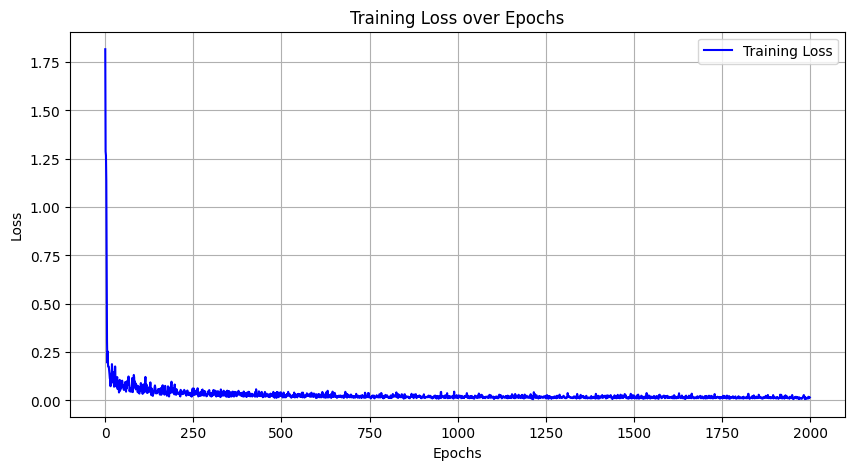

In [ ]:
# Plotting the loss over epochs
plt.figure(figsize=(10, 5))
plt.plot(losses, label='Training Loss', color='blue')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss over Epochs')
plt.legend()
plt.grid(True)
plt.show()

# Train CustomLSTM - 2 **(5 Points)**

* Use Adam optimizer and experiment with various learning rates
* Use MSE Loss
* Test the customLSTM on sample test point first and then on batch test data
* Use a combination of hyperparameters which lead to fastest convergence
* -- (less epochs for training) with less expenses for MSE loss


In [ ]:
# Train customLSTM - 2
# Plot loss and accuracy curves
# Print Training accuracy


# Initialize and Train with MSE Loss
input_size = 1
hidden_size = 32
output_size = 1

model_MSE = customLSTM(input_size, hidden_size, output_size).to(device)
criterion_MSE = nn.MSELoss()
optimizer_MSE = optim.Adam(model_MSE.parameters(), lr=0.01)

num_epochs = 500

# Training
losses = []
for epoch in range(num_epochs):
    running_loss = 0.0

    for X_batch, y_batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        X_batch = X_batch.unsqueeze(-1).to(device)
        y_batch = y_batch.unsqueeze(-1).to(device)

        optimizer_MSE.zero_grad()
        outputs = model_MSE(X_batch)
        loss = criterion_MSE(outputs, y_batch)
        loss.backward()
        optimizer_MSE.step()
        running_loss += loss.item()

    epoch_loss = running_loss / len(train_loader)
    losses.append(epoch_loss)

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {losses[-1]}")


Epoch 1/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 1/500, Loss: 5.803429767489433


Epoch 2/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 2/500, Loss: 2.188269354403019


Epoch 3/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 3/500, Loss: 0.6379571110010147


Epoch 4/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 4/500, Loss: 0.17858108086511493


Epoch 5/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 5/500, Loss: 0.09906159539241344


Epoch 6/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 6/500, Loss: 0.03538142825709656


Epoch 7/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 7/500, Loss: 0.018686795461690053


Epoch 8/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 8/500, Loss: 0.010296558786649257


Epoch 9/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 9/500, Loss: 0.011013575865945313


Epoch 10/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 10/500, Loss: 0.006577967509656446


Epoch 11/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 11/500, Loss: 0.007375004970526788


Epoch 12/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 12/500, Loss: 0.00594126137366402


Epoch 13/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 13/500, Loss: 0.0359550925786607


Epoch 14/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 14/500, Loss: 0.010073989666125271


Epoch 15/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 15/500, Loss: 0.007840576938178856


Epoch 16/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 16/500, Loss: 0.01304942161004874


Epoch 17/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 17/500, Loss: 0.010361313394241733


Epoch 18/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 18/500, Loss: 0.007362315343925729


Epoch 19/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 19/500, Loss: 0.0032419822200608905


Epoch 20/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 20/500, Loss: 0.0025444911425438477


Epoch 21/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 21/500, Loss: 0.0016086639971035765


Epoch 22/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 22/500, Loss: 0.0034761062288453104


Epoch 23/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 23/500, Loss: 0.001865008593085804


Epoch 24/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 24/500, Loss: 0.00406926682262565


Epoch 25/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 25/500, Loss: 0.013034971176239196


Epoch 26/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 26/500, Loss: 0.017239789269297034


Epoch 27/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 27/500, Loss: 0.0054221884383878205


Epoch 28/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 28/500, Loss: 0.002247079059088719


Epoch 29/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 29/500, Loss: 0.0019663245393530815


Epoch 30/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 30/500, Loss: 0.003444351210418972


Epoch 31/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 31/500, Loss: 0.0025762499535630923


Epoch 32/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 32/500, Loss: 0.0028179001756143407


Epoch 33/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 33/500, Loss: 0.0024029904352573794


Epoch 34/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 34/500, Loss: 0.00656106694805203


Epoch 35/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 35/500, Loss: 0.0033089845683207386


Epoch 36/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 36/500, Loss: 0.002155942132048949


Epoch 37/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 37/500, Loss: 0.006947432269953424


Epoch 38/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 38/500, Loss: 0.021267965094011743


Epoch 39/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 39/500, Loss: 0.005756550463047461


Epoch 40/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 40/500, Loss: 0.0019555142398530734


Epoch 41/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 41/500, Loss: 0.006198595863679657


Epoch 42/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 42/500, Loss: 0.00218072451025364


Epoch 43/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 43/500, Loss: 0.0021586416123682284


Epoch 44/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 44/500, Loss: 0.005115139194458607


Epoch 45/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 45/500, Loss: 0.003468814071311499


Epoch 46/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 46/500, Loss: 0.0011277866633463418


Epoch 47/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 47/500, Loss: 0.005581148346209375


Epoch 48/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 48/500, Loss: 0.008274383848402067


Epoch 49/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 49/500, Loss: 0.002202601783665159


Epoch 50/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 50/500, Loss: 0.001604878242687846


Epoch 51/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 51/500, Loss: 0.0014653664311481407


Epoch 52/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 52/500, Loss: 0.004943065008774283


Epoch 53/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 53/500, Loss: 0.003620472092734417


Epoch 54/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 54/500, Loss: 0.0034868860202550422


Epoch 55/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 55/500, Loss: 0.006680684080492938


Epoch 56/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 56/500, Loss: 0.015192138946986233


Epoch 57/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 57/500, Loss: 0.010601750242130947


Epoch 58/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 58/500, Loss: 0.003738834933756152


Epoch 59/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 59/500, Loss: 0.0009320705430582166


Epoch 60/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 60/500, Loss: 0.001751270200657018


Epoch 61/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 61/500, Loss: 0.0021763204144917836


Epoch 62/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 62/500, Loss: 0.00829299397264549


Epoch 63/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 63/500, Loss: 0.0022472305954579497


Epoch 64/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 64/500, Loss: 0.006056839560187655


Epoch 65/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 65/500, Loss: 0.025369451906954055


Epoch 66/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 66/500, Loss: 0.0066869225393020315


Epoch 67/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 67/500, Loss: 0.0018528058585616236


Epoch 68/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 68/500, Loss: 0.0007257882543854066


Epoch 69/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 69/500, Loss: 0.00265385261945994


Epoch 70/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 70/500, Loss: 0.0015655845118089928


Epoch 71/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 71/500, Loss: 0.0050372711921227165


Epoch 72/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 72/500, Loss: 0.0013243787593637535


Epoch 73/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 73/500, Loss: 0.0009433925506527885


Epoch 74/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 74/500, Loss: 0.002243623027425201


Epoch 75/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 75/500, Loss: 0.0005431195879737061


Epoch 76/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 76/500, Loss: 0.0005280824223063973


Epoch 77/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 77/500, Loss: 0.001996307782292206


Epoch 78/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 78/500, Loss: 0.004630455050119053


Epoch 79/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 79/500, Loss: 0.033217503150808625


Epoch 80/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 80/500, Loss: 0.009243366605005576


Epoch 81/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 81/500, Loss: 0.00236940345257608


Epoch 82/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 82/500, Loss: 0.0017638778467699012


Epoch 83/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 83/500, Loss: 0.0014657484307463164


Epoch 84/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 84/500, Loss: 0.0007057417269606958


Epoch 85/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 85/500, Loss: 0.001349917783500132


Epoch 86/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 86/500, Loss: 0.0004802913133516995


Epoch 87/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 87/500, Loss: 0.0002673473718459718


Epoch 88/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 88/500, Loss: 0.00039083514548110543


Epoch 89/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 89/500, Loss: 0.0024101578128465917


Epoch 90/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 90/500, Loss: 0.008938168146414682


Epoch 91/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 91/500, Loss: 0.023001168177870568


Epoch 92/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 92/500, Loss: 0.015856073921895586


Epoch 93/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 93/500, Loss: 0.005842717973791878


Epoch 94/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 94/500, Loss: 0.0005206338796597265


Epoch 95/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 95/500, Loss: 0.0004977103060355148


Epoch 96/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 96/500, Loss: 0.0006070936169635388


Epoch 97/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 97/500, Loss: 0.00114189227042516


Epoch 98/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 98/500, Loss: 0.002034932783772092


Epoch 99/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 99/500, Loss: 0.0019271122619102243


Epoch 100/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 100/500, Loss: 0.0008513276993653562


Epoch 101/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 101/500, Loss: 0.0007581183670026803


Epoch 102/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 102/500, Loss: 0.0005674333315255353


Epoch 103/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 103/500, Loss: 0.0003691073231948394


Epoch 104/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 104/500, Loss: 0.00045053126950733713


Epoch 105/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 105/500, Loss: 0.0004220021241962968


Epoch 106/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 106/500, Loss: 0.0021132538486199337


Epoch 107/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 107/500, Loss: 0.0019359304587851511


Epoch 108/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 108/500, Loss: 0.0027755535294602396


Epoch 109/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 109/500, Loss: 0.004216113333313842


Epoch 110/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 110/500, Loss: 0.003332959257932089


Epoch 111/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 111/500, Loss: 0.0013556929743572255


Epoch 112/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 112/500, Loss: 0.0017178613161377143


Epoch 113/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 113/500, Loss: 0.002649167798608687


Epoch 114/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 114/500, Loss: 0.0003868824776418478


Epoch 115/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 115/500, Loss: 0.0008395030570227391


Epoch 116/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 116/500, Loss: 0.0004574123660177065


Epoch 117/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 117/500, Loss: 0.0027124168245791225


Epoch 118/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 118/500, Loss: 0.006865165165436338


Epoch 119/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 119/500, Loss: 0.005643971482186316


Epoch 120/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 120/500, Loss: 0.001624981966415362


Epoch 121/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 121/500, Loss: 0.0028852198829554254


Epoch 122/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 122/500, Loss: 0.010030990473751444


Epoch 123/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 123/500, Loss: 0.005634045175611391


Epoch 124/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 124/500, Loss: 0.0027471073144624825


Epoch 125/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 125/500, Loss: 0.0017240296165255131


Epoch 126/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 126/500, Loss: 0.0008321579543917323


Epoch 127/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 127/500, Loss: 0.0012857585061283316


Epoch 128/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 128/500, Loss: 0.0007500045414872147


Epoch 129/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 129/500, Loss: 0.0020887549326289445


Epoch 130/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 130/500, Loss: 0.00508386848923692


Epoch 131/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 131/500, Loss: 0.0011297669198029325


Epoch 132/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 132/500, Loss: 0.00200901011305632


Epoch 133/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 133/500, Loss: 0.001937363196248043


Epoch 134/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 134/500, Loss: 0.00164501389031102


Epoch 135/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 135/500, Loss: 0.0019436345319263637


Epoch 136/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 136/500, Loss: 0.001475562502946559


Epoch 137/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 137/500, Loss: 0.02522254981158767


Epoch 138/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 138/500, Loss: 0.031414834200404584


Epoch 139/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 139/500, Loss: 0.0139314327534521


Epoch 140/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 140/500, Loss: 0.0016020058587855601


Epoch 141/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 141/500, Loss: 0.001511166271939146


Epoch 142/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 142/500, Loss: 0.00046037923038966255


Epoch 143/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 143/500, Loss: 0.00037873744395255926


Epoch 144/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 144/500, Loss: 0.0004783314361702651


Epoch 145/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 145/500, Loss: 0.00027987523208139464


Epoch 146/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 146/500, Loss: 0.00021187729214489082


Epoch 147/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 147/500, Loss: 0.0006896246466112643


Epoch 148/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 148/500, Loss: 0.0008107371015739773


Epoch 149/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 149/500, Loss: 0.00026183681188740593


Epoch 150/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 150/500, Loss: 0.0006170103357590051


Epoch 151/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 151/500, Loss: 0.00023809670608443412


Epoch 152/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 152/500, Loss: 0.00026998513607168206


Epoch 153/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 153/500, Loss: 0.00021301736171608354


Epoch 154/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 154/500, Loss: 0.0012582522149386932


Epoch 155/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 155/500, Loss: 0.0010882813367061317


Epoch 156/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 156/500, Loss: 0.00044378750362739083


Epoch 157/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 157/500, Loss: 0.00025403695713066554


Epoch 158/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 158/500, Loss: 0.0014535672798956512


Epoch 159/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 159/500, Loss: 0.0014609189352086105


Epoch 160/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 160/500, Loss: 0.0003553662497779442


Epoch 161/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 161/500, Loss: 0.00019033193950690475


Epoch 162/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 162/500, Loss: 0.00026176554104040406


Epoch 163/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 163/500, Loss: 0.0012535212615603086


Epoch 164/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 164/500, Loss: 0.0007492080987958616


Epoch 165/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 165/500, Loss: 0.0005936669416541918


Epoch 166/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 166/500, Loss: 0.0010381679971942503


Epoch 167/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 167/500, Loss: 0.0003341442425153218


Epoch 168/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 168/500, Loss: 0.003440232112097874


Epoch 169/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 169/500, Loss: 0.0009963758353705998


Epoch 170/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 170/500, Loss: 0.0026147181897613336


Epoch 171/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 171/500, Loss: 0.005489272858540062


Epoch 172/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 172/500, Loss: 0.004289109884666686


Epoch 173/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 173/500, Loss: 0.0032835735564731294


Epoch 174/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 174/500, Loss: 0.0009293019963934057


Epoch 175/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 175/500, Loss: 0.0005094362184081547


Epoch 176/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 176/500, Loss: 0.0028375260549182713


Epoch 177/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 177/500, Loss: 0.0042964257909261505


Epoch 178/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 178/500, Loss: 0.008902817686248454


Epoch 179/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 179/500, Loss: 0.0020121152183492086


Epoch 180/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 180/500, Loss: 0.0008920194438815088


Epoch 181/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 181/500, Loss: 0.0023580005690746475


Epoch 182/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 182/500, Loss: 0.000459654919040986


Epoch 183/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 183/500, Loss: 0.0007165447711940942


Epoch 184/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 184/500, Loss: 0.0007638873740916097


Epoch 185/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 185/500, Loss: 0.0018214871538475563


Epoch 186/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 186/500, Loss: 0.0008540524002000893


Epoch 187/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 187/500, Loss: 0.000511163038140694


Epoch 188/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 188/500, Loss: 0.0025847993686056725


Epoch 189/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 189/500, Loss: 0.00066612489513318


Epoch 190/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 190/500, Loss: 0.0006525693451067127


Epoch 191/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 191/500, Loss: 0.0006541170780565153


Epoch 192/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 192/500, Loss: 0.001162960777492117


Epoch 193/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 193/500, Loss: 0.0006323640734535729


Epoch 194/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 194/500, Loss: 0.00029110183936609246


Epoch 195/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 195/500, Loss: 0.0001992656717106911


Epoch 196/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 196/500, Loss: 0.0002265106450067833


Epoch 197/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 197/500, Loss: 0.0010724578066856338


Epoch 198/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 198/500, Loss: 0.010635427562647237


Epoch 199/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 199/500, Loss: 0.00940605786672677


Epoch 200/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 200/500, Loss: 0.003176430321218504


Epoch 201/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 201/500, Loss: 0.00047443941002711654


Epoch 202/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 202/500, Loss: 0.0016229239722633793


Epoch 203/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 203/500, Loss: 0.0016594283429185452


Epoch 204/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 204/500, Loss: 0.00025495748207049473


Epoch 205/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 205/500, Loss: 0.00023797843016382103


Epoch 206/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 206/500, Loss: 0.0015395118243759498


Epoch 207/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 207/500, Loss: 0.0005861119502696965


Epoch 208/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 208/500, Loss: 0.0007918539872662222


Epoch 209/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 209/500, Loss: 0.00041377387276497757


Epoch 210/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 210/500, Loss: 0.00021327702404505544


Epoch 211/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 211/500, Loss: 0.0004746103867319107


Epoch 212/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 212/500, Loss: 0.0035132337270624703


Epoch 213/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 213/500, Loss: 0.004717897732007259


Epoch 214/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 214/500, Loss: 0.003118915465847749


Epoch 215/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 215/500, Loss: 0.0006389493576079985


Epoch 216/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 216/500, Loss: 0.001196277321469097


Epoch 217/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 217/500, Loss: 0.0008187066237042018


Epoch 218/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 218/500, Loss: 0.00037945881501855183


Epoch 219/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 219/500, Loss: 0.0013172629974178562


Epoch 220/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 220/500, Loss: 0.0005785528667274775


Epoch 221/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 221/500, Loss: 0.0008392829407739555


Epoch 222/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 222/500, Loss: 0.0007988740142081951


Epoch 223/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 223/500, Loss: 0.0009107194882744807


Epoch 224/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 224/500, Loss: 0.0008906214493435982


Epoch 225/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 225/500, Loss: 0.007916399419627851


Epoch 226/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 226/500, Loss: 0.018039173159195343


Epoch 227/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 227/500, Loss: 0.022655926153674955


Epoch 228/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 228/500, Loss: 0.003680578291096026


Epoch 229/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 229/500, Loss: 0.001495710390372551


Epoch 230/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 230/500, Loss: 0.0007660492681225151


Epoch 231/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 231/500, Loss: 0.00023326733776229958


Epoch 232/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 232/500, Loss: 0.00020637068564610672


Epoch 233/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 233/500, Loss: 0.00026743884075131064


Epoch 234/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 234/500, Loss: 0.00016133541566887288


Epoch 235/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 235/500, Loss: 7.250559809790502e-05


Epoch 236/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 236/500, Loss: 5.2523954252592375e-05


Epoch 237/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 237/500, Loss: 0.00014565929473064898


Epoch 238/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 238/500, Loss: 7.30432492446198e-05


Epoch 239/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 239/500, Loss: 9.712796548910774e-05


Epoch 240/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 240/500, Loss: 0.00011317532448629208


Epoch 241/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 241/500, Loss: 7.825630285651641e-05


Epoch 242/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 242/500, Loss: 0.00010640332328648583


Epoch 243/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 243/500, Loss: 8.934466416121722e-05


Epoch 244/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 244/500, Loss: 0.00017006923934559381


Epoch 245/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 245/500, Loss: 6.914450375461456e-05


Epoch 246/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 246/500, Loss: 7.46948743426401e-05


Epoch 247/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 247/500, Loss: 6.553141258791584e-05


Epoch 248/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 248/500, Loss: 5.30481574969599e-05


Epoch 249/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 249/500, Loss: 0.00027476167531403917


Epoch 250/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 250/500, Loss: 0.0003118536300235064


Epoch 251/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 251/500, Loss: 0.0009239696428267052


Epoch 252/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 252/500, Loss: 0.0004985469296343581


Epoch 253/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 253/500, Loss: 0.000961525853654166


Epoch 254/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 254/500, Loss: 0.00017957212628516572


Epoch 255/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 255/500, Loss: 8.935748101635e-05


Epoch 256/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 256/500, Loss: 0.0027133812274087177


Epoch 257/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 257/500, Loss: 0.003942479866964277


Epoch 258/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 258/500, Loss: 0.00479956493654754


Epoch 259/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 259/500, Loss: 0.0025472013753642386


Epoch 260/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 260/500, Loss: 0.0008253658884314063


Epoch 261/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 261/500, Loss: 0.00029406148792077147


Epoch 262/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 262/500, Loss: 0.0010163977800630164


Epoch 263/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 263/500, Loss: 0.0004432758098573686


Epoch 264/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 264/500, Loss: 0.0003918932966371358


Epoch 265/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 265/500, Loss: 0.0003201415215698944


Epoch 266/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 266/500, Loss: 0.0010489160088127392


Epoch 267/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 267/500, Loss: 0.0011268152879893023


Epoch 268/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 268/500, Loss: 0.0005059866239207622


Epoch 269/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 269/500, Loss: 0.00019971046503997059


Epoch 270/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 270/500, Loss: 0.0019122034582323977


Epoch 271/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 271/500, Loss: 0.011730632180842804


Epoch 272/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 272/500, Loss: 0.01063957968426621


Epoch 273/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 273/500, Loss: 0.0021659106828337826


Epoch 274/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 274/500, Loss: 0.0011488775664929562


Epoch 275/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 275/500, Loss: 0.00040916823490988463


Epoch 276/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 276/500, Loss: 0.00044517581784475624


Epoch 277/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 277/500, Loss: 5.2175460922399e-05


Epoch 278/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 278/500, Loss: 3.7950045879142635e-05


Epoch 279/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 279/500, Loss: 0.00026251857491388364


Epoch 280/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 280/500, Loss: 0.0012722616856990498


Epoch 281/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 281/500, Loss: 0.000296336549638454


Epoch 282/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 282/500, Loss: 0.00011476930382059436


Epoch 283/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 283/500, Loss: 0.00014456905734050451


Epoch 284/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 284/500, Loss: 0.0005149030624238549


Epoch 285/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 285/500, Loss: 0.00020948869695303074


Epoch 286/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 286/500, Loss: 0.00016743525759466138


Epoch 287/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 287/500, Loss: 8.659705218860836e-05


Epoch 288/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 288/500, Loss: 0.00013586027182554972


Epoch 289/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 289/500, Loss: 0.0002783426708674597


Epoch 290/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 290/500, Loss: 0.0003871384615194984


Epoch 291/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 291/500, Loss: 0.0010584128547179716


Epoch 292/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 292/500, Loss: 0.00127229251756944


Epoch 293/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 293/500, Loss: 0.0005455774266920344


Epoch 294/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 294/500, Loss: 0.0010158025838791218


Epoch 295/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 295/500, Loss: 0.0030356855186255416


Epoch 296/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 296/500, Loss: 0.001105962283872941


Epoch 297/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 297/500, Loss: 0.0005181269809781952


Epoch 298/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 298/500, Loss: 0.0029082251782028834


Epoch 299/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 299/500, Loss: 0.0017223596935309615


Epoch 300/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 300/500, Loss: 0.0009907594380820228


Epoch 301/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 301/500, Loss: 0.002287286772570951


Epoch 302/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 302/500, Loss: 0.0003664441024966436


Epoch 303/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 303/500, Loss: 0.00023689102130219908


Epoch 304/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 304/500, Loss: 7.77582594650994e-05


Epoch 305/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 305/500, Loss: 7.10485683157458e-05


Epoch 306/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 306/500, Loss: 0.00021646065340519272


Epoch 307/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 307/500, Loss: 0.0009477174587573245


Epoch 308/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 308/500, Loss: 0.0006944817703242734


Epoch 309/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 309/500, Loss: 0.00305153648241685


Epoch 310/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 310/500, Loss: 0.016431614694738528


Epoch 311/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 311/500, Loss: 0.014148507078061812


Epoch 312/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 312/500, Loss: 0.007791690084559377


Epoch 313/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 313/500, Loss: 0.0029614648110509734


Epoch 314/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 314/500, Loss: 0.0011136565008200705


Epoch 315/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 315/500, Loss: 0.0008815394976409152


Epoch 316/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 316/500, Loss: 0.0006129774508281116


Epoch 317/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 317/500, Loss: 0.00018515861648893406


Epoch 318/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 318/500, Loss: 0.0001041766578282477


Epoch 319/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 319/500, Loss: 9.558157410083368e-05


Epoch 320/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 320/500, Loss: 0.00010491803254808474


Epoch 321/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 321/500, Loss: 6.074192504001985e-05


Epoch 322/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 322/500, Loss: 2.4755719266522647e-05


Epoch 323/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 323/500, Loss: 2.406343455163551e-05


Epoch 324/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 324/500, Loss: 6.732136031928349e-05


Epoch 325/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 325/500, Loss: 5.717334585142453e-05


Epoch 326/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 326/500, Loss: 2.619523213809316e-05


Epoch 327/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 327/500, Loss: 3.414321179207036e-05


Epoch 328/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 328/500, Loss: 2.840989699848251e-05


Epoch 329/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 329/500, Loss: 3.5588265092201254e-05


Epoch 330/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 330/500, Loss: 0.00013085467520568272


Epoch 331/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 331/500, Loss: 7.545649933149434e-05


Epoch 332/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 332/500, Loss: 4.201331287845278e-05


Epoch 333/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 333/500, Loss: 0.000134109011014516


Epoch 334/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 334/500, Loss: 0.00015233209018106209


Epoch 335/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 335/500, Loss: 0.0001501927155231897


Epoch 336/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 336/500, Loss: 9.000669750491852e-05


Epoch 337/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 337/500, Loss: 5.4079830334785584e-05


Epoch 338/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 338/500, Loss: 0.00013650037683987648


Epoch 339/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 339/500, Loss: 0.0001312006248213038


Epoch 340/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 340/500, Loss: 0.00023863795223633133


Epoch 341/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 341/500, Loss: 0.0010123243316684238


Epoch 342/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 342/500, Loss: 0.008994483952847077


Epoch 343/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 343/500, Loss: 0.0017902989761751087


Epoch 344/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 344/500, Loss: 0.0009856534966274921


Epoch 345/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 345/500, Loss: 0.0006050431850326277


Epoch 346/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 346/500, Loss: 0.0003893135444741347


Epoch 347/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 347/500, Loss: 0.0014401109435766557


Epoch 348/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 348/500, Loss: 0.004446379752153007


Epoch 349/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 349/500, Loss: 0.00022060770663756557


Epoch 350/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 350/500, Loss: 0.00023454507629594445


Epoch 351/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 351/500, Loss: 0.00022256988245317189


Epoch 352/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 352/500, Loss: 0.00012866652656384758


Epoch 353/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 353/500, Loss: 9.079923779609089e-05


Epoch 354/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 354/500, Loss: 2.261739109599148e-05


Epoch 355/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 355/500, Loss: 3.6150917537725036e-05


Epoch 356/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 356/500, Loss: 6.44357261165851e-05


Epoch 357/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 357/500, Loss: 0.0006240275841946641


Epoch 358/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 358/500, Loss: 0.0007798234167921692


Epoch 359/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 359/500, Loss: 0.0007218871462555398


Epoch 360/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 360/500, Loss: 0.0024634849569338257


Epoch 361/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 361/500, Loss: 0.002924821449596493


Epoch 362/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 362/500, Loss: 0.006759465308277868


Epoch 363/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 363/500, Loss: 0.006461253864472383


Epoch 364/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 364/500, Loss: 0.0009687835813565471


Epoch 365/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 365/500, Loss: 0.0005407321409620636


Epoch 366/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 366/500, Loss: 0.0021855242430319777


Epoch 367/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 367/500, Loss: 0.0019222082187297929


Epoch 368/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 368/500, Loss: 0.0003839181613329856


Epoch 369/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 369/500, Loss: 8.85934725260995e-05


Epoch 370/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 370/500, Loss: 8.018272035315022e-05


Epoch 371/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 371/500, Loss: 4.106586087004871e-05


Epoch 372/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 372/500, Loss: 0.00016557163581865098


Epoch 373/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 373/500, Loss: 0.00010684664921711828


Epoch 374/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 374/500, Loss: 6.2040287190257e-05


Epoch 375/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 375/500, Loss: 0.00011437113960255374


Epoch 376/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 376/500, Loss: 7.273018718478852e-05


Epoch 377/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 377/500, Loss: 0.0002683685646616141


Epoch 378/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 378/500, Loss: 0.00017312515842604626


Epoch 379/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 379/500, Loss: 0.00013079659959203127


Epoch 380/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 380/500, Loss: 0.000737042764171747


Epoch 381/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 381/500, Loss: 0.0005589188731391914


Epoch 382/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 382/500, Loss: 0.0002858565475207797


Epoch 383/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 383/500, Loss: 0.0005521332836906367


Epoch 384/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 384/500, Loss: 0.00025122717647718673


Epoch 385/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 385/500, Loss: 4.247338992513505e-05


Epoch 386/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 386/500, Loss: 6.917546784279693e-05


Epoch 387/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 387/500, Loss: 0.000612623426150094


Epoch 388/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 388/500, Loss: 0.00028951176977898285


Epoch 389/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 389/500, Loss: 0.0008108105487281136


Epoch 390/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 390/500, Loss: 0.0007444458235568163


Epoch 391/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 391/500, Loss: 0.001731499533434544


Epoch 392/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 392/500, Loss: 0.0007156670653785113


Epoch 393/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 393/500, Loss: 0.0002689766469075039


Epoch 394/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 394/500, Loss: 0.00023505303164483848


Epoch 395/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 395/500, Loss: 0.0008475518410477889


Epoch 396/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 396/500, Loss: 0.011212388115382055


Epoch 397/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 397/500, Loss: 0.005511219987965887


Epoch 398/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 398/500, Loss: 0.015011358527772245


Epoch 399/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 399/500, Loss: 0.008029936743696453


Epoch 400/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 400/500, Loss: 0.0014696457583340816


Epoch 401/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 401/500, Loss: 0.0008477027415665361


Epoch 402/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 402/500, Loss: 0.00021677399047348445


Epoch 403/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 403/500, Loss: 9.259969499453291e-05


Epoch 404/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 404/500, Loss: 7.381436657283302e-05


Epoch 405/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 405/500, Loss: 0.0001679715634850254


Epoch 406/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 406/500, Loss: 5.068361792837095e-05


Epoch 407/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 407/500, Loss: 3.750219295284296e-05


Epoch 408/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 408/500, Loss: 3.7523111075188353e-05


Epoch 409/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 409/500, Loss: 1.744387711255513e-05


Epoch 410/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 410/500, Loss: 1.5946979502245995e-05


Epoch 411/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 411/500, Loss: 1.507566287273221e-05


Epoch 412/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 412/500, Loss: 1.9271764784889456e-05


Epoch 413/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 413/500, Loss: 2.2467757531785537e-05


Epoch 414/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 414/500, Loss: 1.555223103366643e-05


Epoch 415/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 415/500, Loss: 1.3701175319624781e-05


Epoch 416/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 416/500, Loss: 2.823531772833121e-05


Epoch 417/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 417/500, Loss: 1.3820594702451672e-05


Epoch 418/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 418/500, Loss: 2.1656419022519913e-05


Epoch 419/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 419/500, Loss: 8.368848367013015e-05


Epoch 420/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 420/500, Loss: 0.0001552386050889254


Epoch 421/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 421/500, Loss: 0.0001918588454827841


Epoch 422/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 422/500, Loss: 5.505406596739704e-05


Epoch 423/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 423/500, Loss: 4.6550233179232237e-05


Epoch 424/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 424/500, Loss: 2.527604658553173e-05


Epoch 425/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 425/500, Loss: 3.2179027371626034e-05


Epoch 426/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 426/500, Loss: 2.8298425846173814e-05


Epoch 427/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 427/500, Loss: 1.206109925533383e-05


Epoch 428/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 428/500, Loss: 1.235082953598976e-05


Epoch 429/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 429/500, Loss: 3.0145550368843033e-05


Epoch 430/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 430/500, Loss: 0.00024878176958509357


Epoch 431/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 431/500, Loss: 0.0003142899927297549


Epoch 432/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 432/500, Loss: 0.0018080898585139948


Epoch 433/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 433/500, Loss: 0.001808398818866408


Epoch 434/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 434/500, Loss: 0.0031219407173921354


Epoch 435/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 435/500, Loss: 0.0014231966133593232


Epoch 436/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 436/500, Loss: 0.0013422421966424736


Epoch 437/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 437/500, Loss: 0.0020494094339937874


Epoch 438/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 438/500, Loss: 0.0031245912919075636


Epoch 439/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 439/500, Loss: 0.0008157216402082668


Epoch 440/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 440/500, Loss: 0.0006341616042391252


Epoch 441/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 441/500, Loss: 0.00019454100325333457


Epoch 442/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 442/500, Loss: 7.49321239368328e-05


Epoch 443/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 443/500, Loss: 4.6761680124518534e-05


Epoch 444/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 444/500, Loss: 3.9901630543681676e-05


Epoch 445/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 445/500, Loss: 0.00024979941355240953


Epoch 446/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 446/500, Loss: 0.00025420717878432697


Epoch 447/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 447/500, Loss: 4.474753254157804e-05


Epoch 448/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 448/500, Loss: 2.6945522890287066e-05


Epoch 449/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 449/500, Loss: 1.3561300463038606e-05


Epoch 450/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 450/500, Loss: 1.2051739378904358e-05


Epoch 451/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 451/500, Loss: 5.261365708975063e-05


Epoch 452/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 452/500, Loss: 0.00012530332773508235


Epoch 453/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 453/500, Loss: 0.0018379428615844517


Epoch 454/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 454/500, Loss: 0.0036156656342427596


Epoch 455/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 455/500, Loss: 0.007315867733268533


Epoch 456/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 456/500, Loss: 0.001996826905724447


Epoch 457/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 457/500, Loss: 0.000548619684195728


Epoch 458/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 458/500, Loss: 0.0005579221249263355


Epoch 459/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 459/500, Loss: 0.0012512592668372235


Epoch 460/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 460/500, Loss: 0.00024427277924132795


Epoch 461/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 461/500, Loss: 7.080342632548309e-05


Epoch 462/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 462/500, Loss: 8.315388919299949e-05


Epoch 463/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 463/500, Loss: 6.34429376020762e-05


Epoch 464/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 464/500, Loss: 0.00019846756993047165


Epoch 465/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 465/500, Loss: 0.00012483020043418946


Epoch 466/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 466/500, Loss: 0.00012868927706222166


Epoch 467/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 467/500, Loss: 6.055073524180443e-05


Epoch 468/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 468/500, Loss: 8.703866507175917e-05


Epoch 469/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 469/500, Loss: 3.3056495624350646e-05


Epoch 470/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 470/500, Loss: 6.324153272885269e-05


Epoch 471/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 471/500, Loss: 4.335124828003245e-05


Epoch 472/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 472/500, Loss: 3.3623243382407964e-05


Epoch 473/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 473/500, Loss: 0.00015808115578863635


Epoch 474/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 474/500, Loss: 0.0009565130731061799


Epoch 475/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 475/500, Loss: 0.0006763825767848175


Epoch 476/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 476/500, Loss: 0.0006463659779001318


Epoch 477/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 477/500, Loss: 0.0005626958825359907


Epoch 478/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 478/500, Loss: 0.0006145107420252316


Epoch 479/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 479/500, Loss: 0.00017874848958854272


Epoch 480/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 480/500, Loss: 0.0002828375547210271


Epoch 481/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 481/500, Loss: 0.0009733745052926679


Epoch 482/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 482/500, Loss: 0.004716361972896266


Epoch 483/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 483/500, Loss: 0.0021993440982441825


Epoch 484/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 484/500, Loss: 0.002021155395595997


Epoch 485/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 485/500, Loss: 0.00063131578804132


Epoch 486/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 486/500, Loss: 0.0002520061107134097


Epoch 487/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 487/500, Loss: 0.00012122730390728975


Epoch 488/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 488/500, Loss: 0.00029352640717661416


Epoch 489/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 489/500, Loss: 0.00030888824119301717


Epoch 490/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 490/500, Loss: 0.0002633085049978945


Epoch 491/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 491/500, Loss: 0.0001784377585636321


Epoch 492/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 492/500, Loss: 9.278317912730927e-05


Epoch 493/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 493/500, Loss: 0.00013607938768700478


Epoch 494/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 494/500, Loss: 8.990591135216164e-05


Epoch 495/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 495/500, Loss: 0.00023333785850354616


Epoch 496/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 496/500, Loss: 0.0004878648747990155


Epoch 497/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 497/500, Loss: 0.0005671826623938614


Epoch 498/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 498/500, Loss: 9.949477953341557e-05


Epoch 499/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 499/500, Loss: 7.46043208721403e-05


Epoch 500/500:   0%|          | 0/32 [00:00<?, ?it/s]

Epoch 500/500, Loss: 0.0011485757255513818


### Testing on 1 sample point

In [ ]:
# Reshape X_test to the desired shape [X_test_length, 1, 1]
X_test = X_test.view(10, 1, 1).to(device)
model_MSE.eval()
with torch.no_grad():
    test_output = model_MSE(X_test)
    print(f"Predicted: {test_output.squeeze()[-1].item()}, Actual: {y_test.item()}")

Predicted: 3.0474579334259033, Actual: 7


### Testing on batch

In [ ]:
model_MSE.eval()

total_loss = 0.0

# Define the loss criterion for evaluation (same as during training)
criterion_MSE = nn.MSELoss()


with torch.no_grad():  # No need to compute gradients during evaluation
    for X_batch, y_batch in test_loader_batch:

        X_batch = X_batch.float()
        y_batch = y_batch.float()

        X_batch = X_batch.unsqueeze(-1).to(device)
        y_batch = y_batch.unsqueeze(-1).to(device)

        # Make predictions with the model
        outputs = model_MSE(X_batch)

        # Calculate loss
        loss = criterion_MSE(outputs, y_batch)
        total_loss += loss.item()

        predictions = outputs.squeeze()  # Squeeze to remove unnecessary dimensions

# Calculate average loss and accuracy
avg_loss = total_loss / len(test_loader_batch)

print("Predictions:")
print(predictions)

#true labels
print(Testing_Y)

# Print evaluation results
print(f"Test Loss: {avg_loss}")


Predictions:
tensor([4.9471, 3.9321, 5.9437, 3.9417, 2.9261, 5.9430, 3.9306, 3.9330, 6.9488,
        2.9145], device='cuda:0')
tensor([3., 4., 6., 6., 5., 4., 7., 3., 4., 4.], dtype=torch.float64)
Test Loss: 0.00419297069311142


### Plot loss

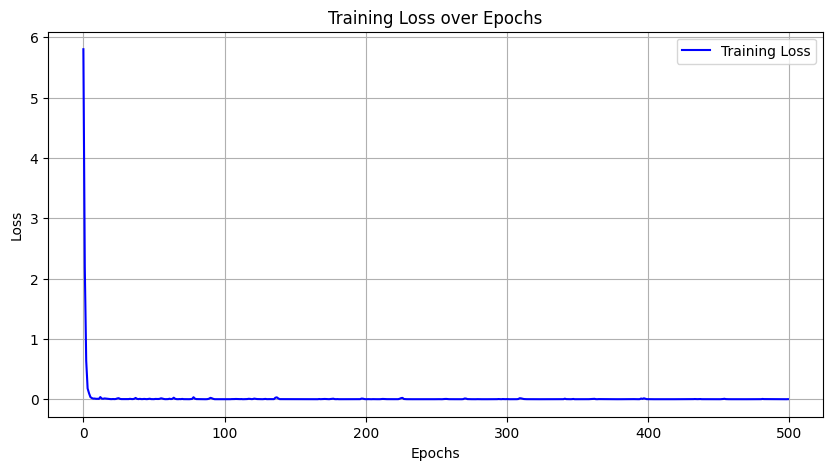

In [ ]:
# Plotting the loss over epochs
plt.figure(figsize=(10, 5))
plt.plot(losses, label='Training Loss', color='blue')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss over Epochs')
plt.legend()
plt.grid(True)
plt.show()

# Test Best CustomLSTM **(5 Points)**

### Testing on best(MSE loss) model

In [ ]:
model_MSE.eval()

total_loss = 0.0

# Define the loss criterion for evaluation (same as during training)
criterion_MSE = nn.MSELoss()

# Iterate through the test data
with torch.no_grad():  # No need to compute gradients during evaluation
    for X_batch, y_batch in test_loader_batch:

        X_batch = X_batch.float()
        y_batch = y_batch.float()

        X_batch = X_batch.unsqueeze(-1).to(device)
        y_batch = y_batch.unsqueeze(-1).to(device)

        # Make predictions with the model
        outputs = model_MSE(X_batch)

        # Calculate loss
        loss = criterion_MSE(outputs, y_batch)
        total_loss += loss.item()

        predictions = outputs.squeeze()

# Calculate average loss and accuracy
avg_loss = total_loss / len(test_loader_batch)

print("Predictions:")
print(predictions)

#true labels
print(Testing_Y)

# Print evaluation results
print(f"Test Loss: {avg_loss}")


Predictions:
tensor([5.9430, 2.9261, 4.9471, 2.9145, 3.9330, 6.9488, 3.9417, 5.9437, 3.9321,
        3.9306], device='cuda:0')
tensor([3., 4., 6., 6., 5., 4., 7., 3., 4., 4.], dtype=torch.float64)
Test Loss: 0.00419297069311142


# Detailed Inferences / Observations **(5 Points)**

So assigment asked us to plot the accuraccy graph but calculating accuraccy on regression task does not make any sense. Also I observed network takes less number of epochs to converge if we use MSE as a loss function. It is taking huge number of epochs to train this network add as I keep increasing the number of epochs the more(tested till 4000 epochs) closer I get to the actual values. There is no mention of number of LSTM cells we should use, so I used only 1 LSTM cell, maybe using more will improve the results and would take less number of epochs for convergence.
